In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

# Preprocessing

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image

Text(0.5, 1.0, 'Detected lines')

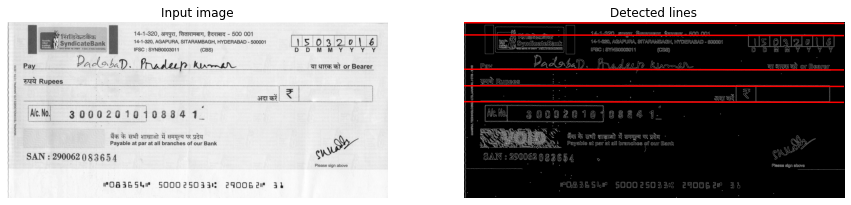

In [ ]:

import numpy as np
from skimage.transform import hough_line, hough_line_peaks
from skimage.transform import rotate
from skimage.feature import canny
from skimage.io import imread
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
from scipy.stats import mode

image = imread("/content/gdrive/MyDrive/vierge/Cheque 083654.png")
# (h, w) = image.shape[:2]
# (cX, cY) = (w // 2, h // 2)
# # rotate our image by 45 degrees around the center of the image
# M = cv2.getRotationMatrix2D((cX, cY), 3, 1.0)
# rotated = cv2.warpAffine(image, M, (w, h))
# cv2_imshow(rotated)
image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
edges = canny(image)
#Classic straight-line Hough transform
tested_angles = np.deg2rad(np.arange(0.1, 180.0))
h, theta, d = hough_line(edges, theta=tested_angles)

# Generating figure 1
fig, axes = plt.subplots(1, 2, figsize=(15, 16))
ax = axes.ravel()

ax[0].imshow(image, cmap="gray")
ax[0].set_title('Input image')
ax[0].set_axis_off()

ax[1].imshow(edges, cmap="gray")
origin = np.array((0, image.shape[1]))

for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
    y0, y1 = (dist - origin * np.cos(angle)) / np.sin(angle)
    ax[1].plot(origin, (y0, y1), '-r')
    
ax[1].set_xlim(origin)
ax[1].set_ylim((edges.shape[0], 0))
ax[1].set_axis_off()
ax[1].set_title('Detected lines')

In [ ]:
def skew_angle_hough_transform(image):
    # convert to edges
    edges = canny(image)
    # Classic straight-line Hough transform between 0.1 - 180 degrees.
    tested_angles = np.deg2rad(np.arange(0.1, 180.0))
    h, theta, d = hough_line(edges, theta=tested_angles)
    
    # find line peaks and angles
    accum, angles, dists = hough_line_peaks(h, theta, d)
    
    # round the angles to 2 decimal places and find the most common angle.
    most_common_angle = mode(np.around(angles, decimals=2))[0]
    
    # convert the angle to degree for rotation.
    skew_angle = np.rad2deg(most_common_angle - np.pi/2)
    return skew_angle

In [ ]:
skew_angle_hough_transform(image)

array([-0.04562616])

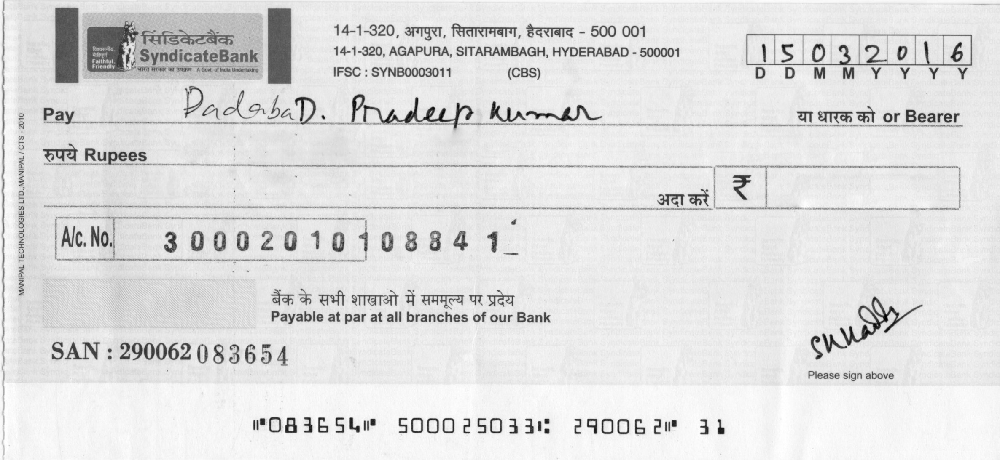

In [ ]:
(h, w) = image.shape[:2]
(cX, cY) = (w // 2, h // 2)
# rotate our image by 45 degrees around the center of the image
M = cv2.getRotationMatrix2D((cX, cY), skew_angle_hough_transform(image), 1.0)
# re_rotated = cv2.warpAffine(rotated, M, (w, h))
rotated_3 = cv2.warpAffine(image, M, (w, h))
cv2_imshow(rotated_3)

In [ ]:
image1 = imread("/content/gdrive/MyDrive/test/Cheque 309100.tif")
image1=cv2.cvtColor(image1,cv2.COLOR_BGR2GRAY)

In [ ]:
skew_angle_hough_transform(image1)

array([-0.04562616])

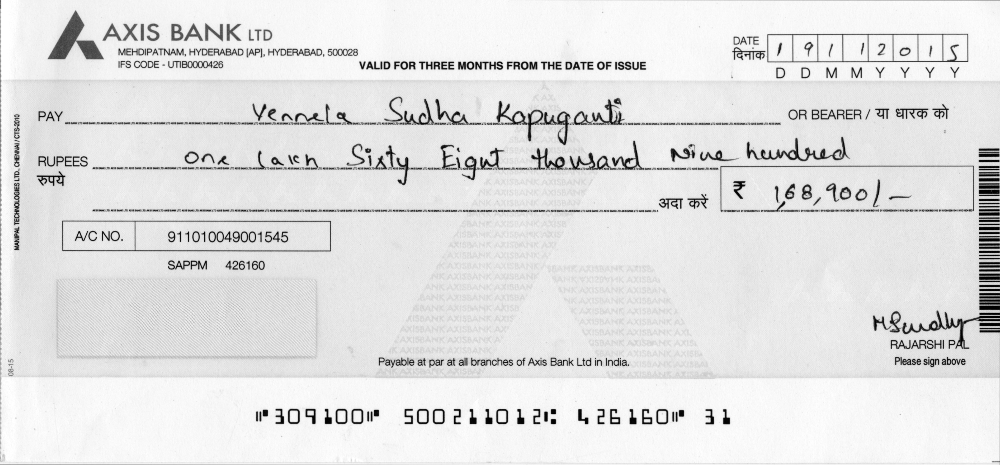

In [ ]:
(h, w) = image1.shape[:2]
(cX, cY) = (w // 2, h // 2)
# rotate our image by 45 degrees around the center of the image
M = cv2.getRotationMatrix2D((cX, cY), skew_angle_hough_transform(image1), 1.0)
# re_rotated = cv2.warpAffine(rotated, M, (w, h))
rotated_2 = cv2.warpAffine(image1, M, (w, h))
cv2_imshow(rotated_2)

In [ ]:
resized = cv2.resize(rotated_2, (2300,1000),)


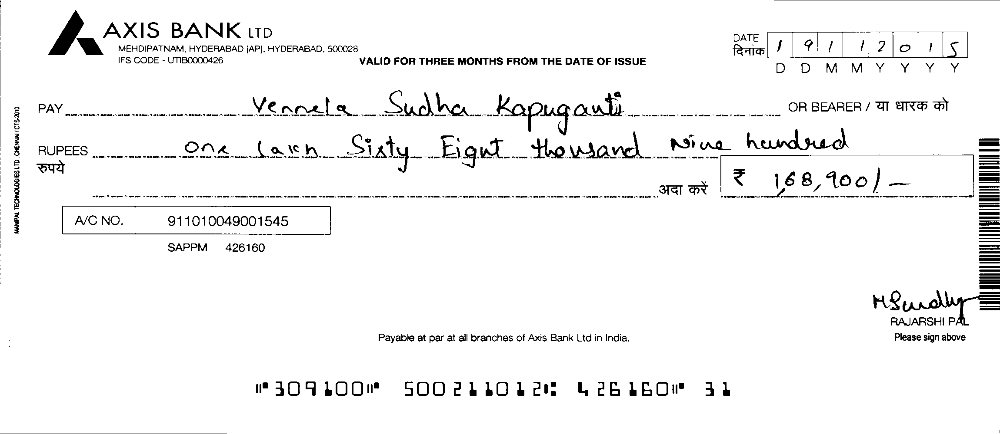

In [ ]:
ret, bw_img = cv2.threshold(resized, 127, 255, cv2.THRESH_BINARY)
 
# converting to its binary form
bw = cv2.threshold(resized, 127, 255, cv2.THRESH_BINARY)
 
cv2_imshow(bw_img)


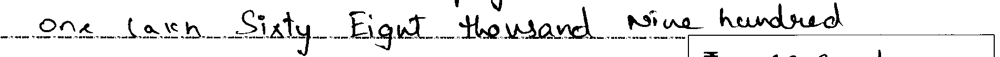

-1

In [ ]:
y=290
x=350
h=110
w=1900
crop1 = bw_img[y:y+h, x:x+w]
cv2_imshow(crop1)
cv2.waitKey(0) 

In [ ]:
crop1.shape

(110, 1900)

In [ ]:
for i in range(63,crop1.shape[0]-20):
  for j in range(2,crop1.shape[1]-2):
    # for z in range (1,200):
          if crop1[i,j]==0 and (crop1[i-4,j]==0 or crop1[i+4,j]==0):
                    crop1[i,j]=0
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #            
          else:
              crop1[i,j]=255
  

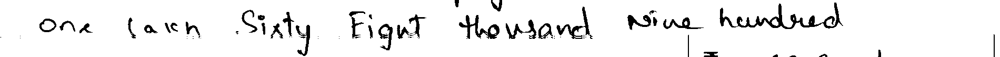

In [ ]:
cv2_imshow(crop1)

In [ ]:
bw_img.shape

(1000, 2300)

# Chèque catégorie 1 : 

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import tensorflow as tf 
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import random
import os

In [ ]:
dirNameDataPNG = 'dataPNG'
if not os.path.exists(dirNameDataPNG):
  os.mkdir(dirNameDataPNG)
  print("Directory " , dirNameDataPNG ,  " Created ")
else:    
  print("Directory " , dirNameDataPNG ,  " already exists")

Directory  dataPNG  Created 


In [ ]:
base_path = "/content/gdrive/MyDrive/turq/"
new_path = "/content/dataPNG/"
for infile in os.listdir(base_path):
  if not "ipynb_checkpoints" in infile:
    print ("file : " + infile)
    read = cv2.imread(base_path + infile)
    outfile = infile.split('.')[0] + '.png'
    cv2.imwrite("/content/"+dirNameDataPNG+"/"+outfile,read,[int(cv2.IMWRITE_JPEG_QUALITY), 200])

file : Cheque 120611.tif
file : Cheque 120612.tif
file : Cheque 120613.tif
file : Cheque 120614.tif
file : Cheque 120615.tif
file : Cheque 120616.tif
file : Cheque 120617.tif


In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      im = Image.open(new_path+infile)
      image = cv2.imread(new_path+infile)
      print(image.shape)
      
      print("")

file : Cheque 120617.png
(1100, 2365, 3)

file : Cheque 120613.png
(1100, 2365, 3)

file : Cheque 120614.png
(1100, 2365, 3)

file : Cheque 120612.png
(1100, 2365, 3)

file : Cheque 120615.png
(1100, 2365, 3)

file : Cheque 120616.png
(1100, 2365, 3)

file : Cheque 120611.png
(1100, 2365, 3)



In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      image = cv2.imread(new_path+infile)
      resized = cv2.resize(image, (2300,1000),)
      cv2.imwrite(new_path+infile,resized)
      print(resized.shape)
      
      print("")

file : Cheque 120617.png
(1000, 2300, 3)

file : Cheque 120613.png
(1000, 2300, 3)

file : Cheque 120614.png
(1000, 2300, 3)

file : Cheque 120612.png
(1000, 2300, 3)

file : Cheque 120615.png
(1000, 2300, 3)

file : Cheque 120616.png
(1000, 2300, 3)

file : Cheque 120611.png
(1000, 2300, 3)



In [ ]:
def center_crop(im, crop_pixels = 45):
    return im[crop_pixels:im.shape[0] - crop_pixels*3, crop_pixels:im.shape[1] - crop_pixels]

In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      im = Image.open(new_path+infile)
      image = cv2.imread(new_path+infile)
      cropped = center_crop(image)
      cv2.imwrite(new_path+infile,cropped)
      print(cropped.shape)
      
      print("")

file : Cheque 120617.png
(820, 2210, 3)

file : Cheque 120613.png
(820, 2210, 3)

file : Cheque 120614.png
(820, 2210, 3)

file : Cheque 120612.png
(820, 2210, 3)

file : Cheque 120615.png
(820, 2210, 3)

file : Cheque 120616.png
(820, 2210, 3)

file : Cheque 120611.png
(820, 2210, 3)



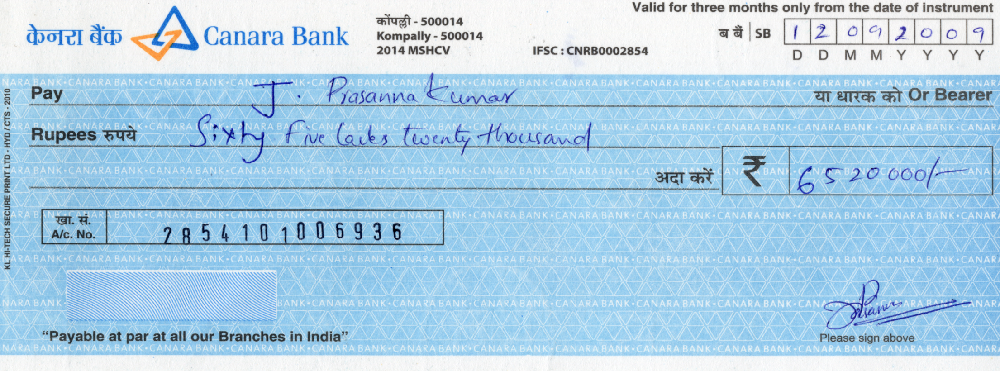

In [ ]:
image1 = cv2.imread("/content/dataPNG/Cheque 120611.png")
cv2_imshow(image1)


In [ ]:
def inverte(imagem, name):
    imagem = (255-imagem)
    cv2.imwrite(name, imagem)

In [ ]:
# get grayscale image
def get_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# noise removal
def remove_noise(image):
    return cv2.medianBlur(image,5)
 
#thresholding
def thresholding(image):
    return cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

#adaptiveThresholding
def adadaptiveThresholding(image):
    return cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,11,2)

#dilation
def dilate(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.dilate(image, kernel, iterations = 1)
    
#erosion
def erode(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.erode(image, kernel, iterations = 1)

#opening - erosion followed by dilation
def opening(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

#canny edge detection
def canny(image):
    return cv2.Canny(image, 100, 200)

#skew correction
def deskew(image):
    coords = np.column_stack(np.where(image > 0))
    angle = cv2.minAreaRect(coords)[-1]
    if angle < -45:
        angle = -(90 + angle)
    else:
        angle = -angle
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(image, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return rotated

#cropping
def cropping(image):
    return image[200:510,200:2200]


#template matching
def match_template(image, template):
    return cv2.matchTemplate(image, template, cv2.TM_CCOEFF_NORMED)

In [ ]:
List = ["thousand","hundred","million","eleven","twelve","thirteen","fourteen","fifteen","sixteen","seventeen","eighteen","nineteen",
        "twenty","thirty","forty","fifty","sixty","seventy","eighty","ninety","lakhs",
        "one","two","three","four","five","six","seven","eight","nine","ten"]

In [ ]:
!pip install jellyfish

     |████████████████████████████████| 132 kB 5.3 MB/s 
  Created wheel for jellyfish: filename=jellyfish-0.9.0-cp37-cp37m-linux_x86_64.whl size=73973 sha256=b35d8bcb4aa670fdd7d84765c1a8689a11a35a559c8ec509ba5eac9eb8ca0db8
  Stored in directory: /root/.cache/pip/wheels/fe/99/4e/646ce766df0d070b0ef04db27aa11543e2767fda3075aec31b
Successfully built jellyfish


In [ ]:
import jellyfish
def dictionnaire(a):
  max=20
  word=""
  for x in List : 
    if (a==x):
      return a
  for x  in List :
    n=jellyfish.levenshtein_distance(a,x)
    if n< max :
      word=x
      max=n
      a=a.replace("n","u")
      for x  in List :
       n=jellyfish.levenshtein_distance(a,x)
       if n< max :
        word=x
        max=n
        a=a.replace("u","n")
        for x  in List :
            n=jellyfish.levenshtein_distance(a,x)
            if n< max :
               word=x
               max=n
               a.replace("z","t")
               for x  in List :
                   n=jellyfish.levenshtein_distance(a,x)
                   if n< max :
                      word=x
                      max=n
  for x  in List :
      n=jellyfish.levenshtein_distance(a,x)
      if (n==max):
         word=x
         return word
  



In [ ]:
txt = "tuo thousand twenti too"
def correct(x):
  x = txt.split(" ")
  l=""
  for i in x:
     l = l + str(dictionnaire(i)) + " "
  print(l) 
x= str(correct(txt))
type(x)

two thousand twenty two 


str

In [ ]:
def text2int(textnum, numwords={}):
    if not numwords:
      units = [
        "zero", "one", "two", "three", "four", "five", "six", "seven", "eight",
        "nine", "ten", "eleven", "twelve", "thirteen", "fourteen", "fifteen",
        "sixteen", "seventeen", "eighteen", "nineteen",
      ]

      tens = ["", "", "twenty", "thirty", "forty", "fifty", "sixty", "seventy", "eighty", "ninety"]

      scales = ["hundred", "thousand","lakhs","million","crores","billion", "trillion"]

      numwords["and"] = (1, 0)
      for idx, word in enumerate(units):    numwords[word] = (1, idx)
      for idx, word in enumerate(tens):     numwords[word] = (1, idx * 10)
      for idx, word in enumerate(scales):   numwords[word] = (10 ** (idx * 1 or 2), 0)
      
    current = result = 0
    for word in textnum.split():
        if word not in numwords:
          raise Exception("Illegal word: " + word)

        scale, increment = numwords[word]
        current = current * scale + increment
        if scale > 100:
            result += current
            current = 0
    
    return (result + current)*100

text2int("two thousand twenty two ")

4200

In [ ]:
!pip install pytesseract


     |████████████████████████████████| 4.3 MB 5.7 MB/s 
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
import cv2 
import pytesseract

In [ ]:
pytesseract.pytesseract.tesseract_cmd = r'C:\Users\USER\AppData\Local\Tesseract-OCR\tesseract.exe'



In [ ]:
!sudo apt install tesseract-ocr


Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 39 not upgraded.
Need to get 4,795 kB of archives.
After this operation, 15.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Fetched 4,795 kB in 1s (3,965 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl

In [ ]:
pytesseract.pytesseract.tesseract_cmd = r'/usr/bin/tesseract'

In [ ]:
import cv2
import numpy as np


# get grayscale image
def get_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# noise removal
def remove_noise(image):
    return cv2.medianBlur(image,5)
 
#thresholding
def thresholding(image):
    return cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

#dilation
def dilate(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.dilate(image, kernel, iterations = 1)
    
#erosion
def erode(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.erode(image, kernel, iterations = 1)

#opening - erosion followed by dilation
def opening(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

#canny edge detection
def canny(image):
    return cv2.Canny(image, 100, 200)

#skew correction
def deskew(image):
    coords = np.column_stack(np.where(image > 0))
    angle = cv2.minAreaRect(coords)[-1]
    if angle < -45:
        angle = -(90 + angle)
    else:
        angle = -angle
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(image, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return rotated

#template matching
def match_template(image, template):
    return cv2.matchTempla

In [ ]:
def cleanup_text(text):
	# strip out non-ASCII text so we can draw the text on the image
	# using OpenCV
	return "".join([c if ord(c) < 128 else "" for c in text]).strip()

In [ ]:
# OCR the input image using EasyOCR
print("[INFO] OCR'ing input image...")
reader = Reader(['en'], gpu = True)
results = reader.readtext(cropped)

**result 1** Montant en *lettres*

In [ ]:
dirNameDataPNG = 'result'
if not os.path.exists(dirNameDataPNG):
  os.mkdir(dirNameDataPNG)
  print("Directory " , dirNameDataPNG ,  " Created ")
else:    
  print("Directory " , dirNameDataPNG ,  " already exists")

Directory  result  Created 


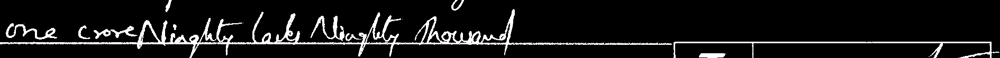

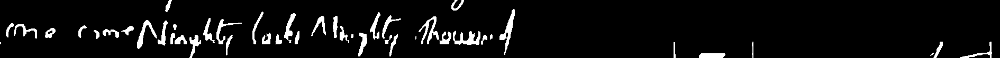

**


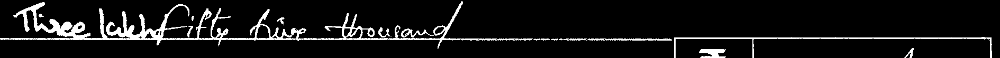

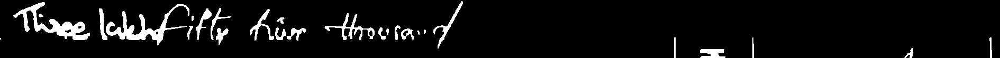

**


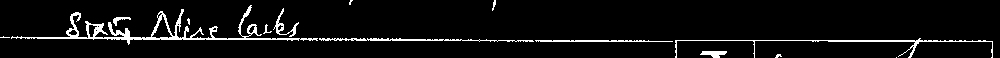

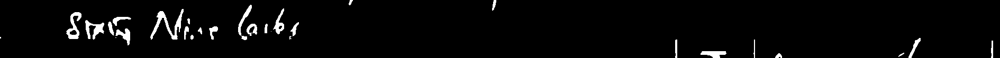

**


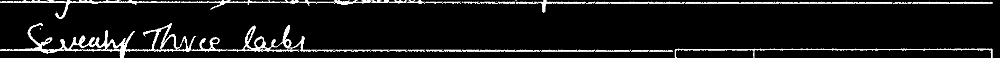

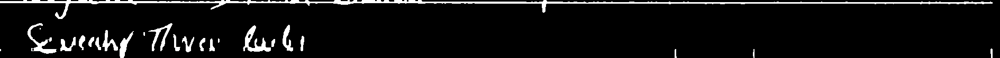

**


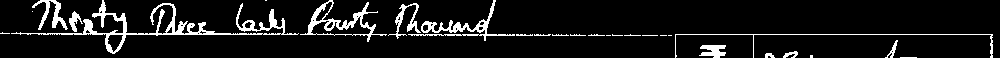

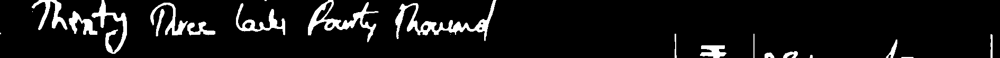

**


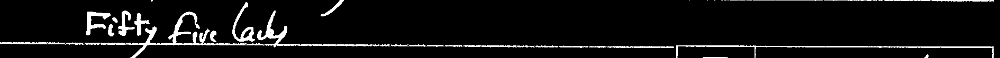

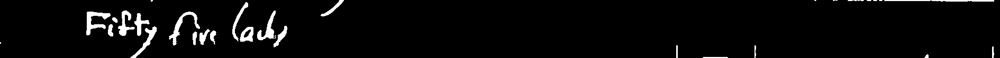

**


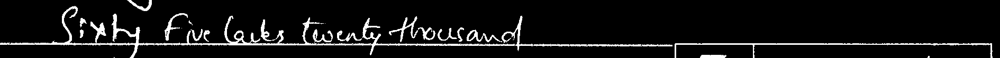

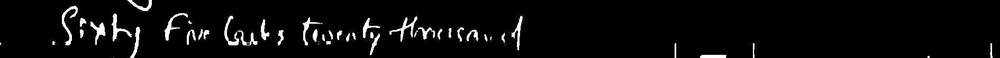

**


In [ ]:
from datetime import datetime

for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=240
      x=320
      h=110
      w=1900
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      cv2_imshow(image)
      # image = cv2.dilate(image,kernel,iterations = 1) 
      for i in range(60,image.shape[0]-10):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
              else:
                    image[i,j]=0              
      # somme_columns=[]
      # for column in image.T:
      #   somme_columns.append(np.sum(column)) 
      # print(somme_columns)
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
      th3 = cv2.morphologyEx(th3, cv2.MORPH_CLOSE, kernel)
      # txt = pytesseract.image_to_string(th3, config="--psm 4")
      # print(correct(txt))
      cv2.imwrite("/content/"+dirNameDataPNG+"/"+infile,th3)
      cv2_imshow(th3)
      # plt.plot(somme_columns)     
      # plt.show() 
      print("**")
      cv2.waitKey(0) 


**Projection horizentale**

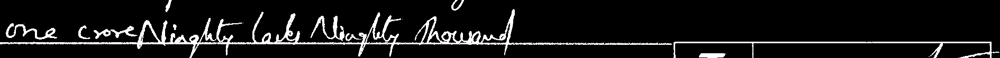

[1020, 1020, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 3060, 3825, 4590, 4590, 2805, 1785, 1785, 1785, 1785, 1530, 1530, 1530, 1785, 1275, 1530, 2805, 4335, 3825, 1785, 1275, 1275, 1020, 1020, 1020, 1020, 1020, 1020, 1020, 1020, 1020, 1275, 1785, 4080, 5610, 4590, 4080, 2550, 510, 765, 510, 765, 765, 1020, 1020, 1020, 1020, 765, 1020, 1020, 765, 1020, 1020, 1020, 1275, 4335, 4590, 4335, 4335, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 0, 510, 2550, 3060, 3315, 3315, 2805, 1785, 1785, 2295, 3060, 3060, 2805, 2295, 2040, 2040, 2805, 2805, 2295, 1785, 765, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2295, 3315, 4080, 4590, 4845, 2040, 2040, 1275, 1020, 1020, 1020, 1275, 1530, 1275, 1275, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 765, 1020, 1020, 2295, 2040, 3570, 3315, 3060, 2295, 1020, 510, 510, 510, 0, 0, 510, 255, 2040, 2295, 2805, 3315, 2805, 1530, 1275, 1530, 1275, 765, 2550, 2295, 2295, 1530, 510, 765

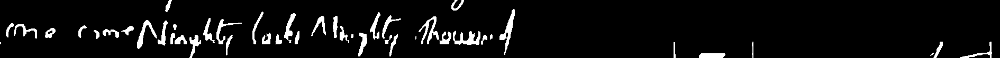

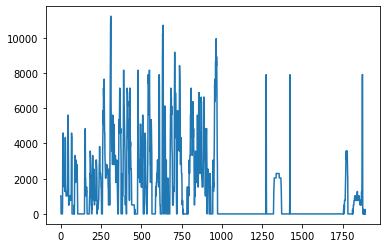

**


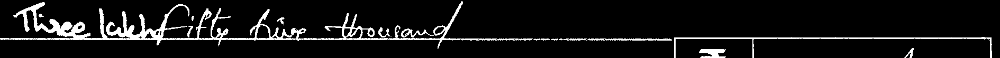

[765, 765, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 1020, 1275, 1275, 1275, 1785, 2040, 1530, 1530, 1530, 1530, 1530, 1530, 1530, 1785, 1530, 1785, 2040, 2550, 3570, 7140, 8925, 10200, 10965, 10965, 9690, 7905, 4590, 3570, 3315, 2295, 1785, 1530, 1530, 2295, 3060, 3060, 4335, 5610, 10455, 10965, 12240, 12750, 11475, 9180, 5865, 5355, 5100, 5610, 5865, 6120, 6375, 5355, 5610, 5100, 5100, 4590, 4335, 4080, 3315, 2295, 2295, 2550, 2295, 2040, 1785, 1530, 1530, 2295, 3570, 4080, 3825, 4335, 4845, 5100, 6120, 6120, 5865, 5865, 5355, 5100, 4845, 5610, 6120, 6375, 6120, 5865, 5355, 4845, 3315, 4335, 4845, 5100, 5100, 5865, 6630, 6630, 6120, 6630, 6630, 6630, 6120, 6120, 5610, 5865, 5610, 5355, 5355, 5100, 5100, 4590, 4590, 4590, 5865, 6630, 7140, 7395, 6630, 6630, 6885, 7395, 7650, 6630, 6120, 5610, 6120, 6375, 6120, 5865, 6630, 6885, 6375, 6375, 5865, 5610, 3570, 1275, 1275, 2295, 2040, 1275, 765, 1275, 1785, 1020, 510, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

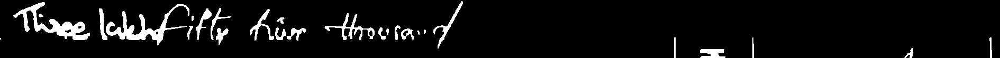

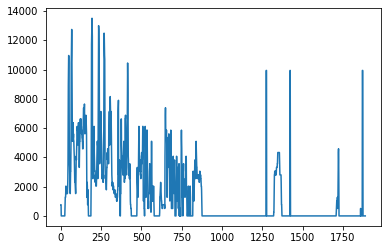

**


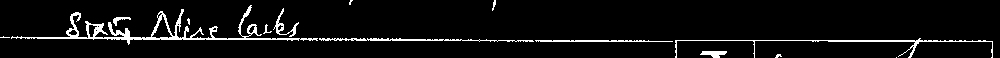

[765, 765, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 1530, 2295, 3060, 3315, 4335, 2805, 3825, 6120, 7395, 7905, 7395, 8160, 7650, 6630, 6375, 5865, 6375, 6375, 6375, 6375, 7140, 6885, 5865, 4590, 3315, 2805, 2295, 1530, 0, 0, 0, 0, 0, 0, 0, 1275, 3570, 4590, 6375, 6885, 8160, 8160, 6630, 3825, 2805, 1020, 765, 765, 765, 2040, 3315, 4845, 5355, 5100, 5100, 4335, 4080, 4335, 4335, 4080, 3570, 3315, 3570, 3570, 3825, 4080, 4335, 4335, 3315, 2550, 1020, 510, 0, 0, 0, 0, 0, 0, 1020, 2295, 3825, 4590, 5100, 5355, 5355, 4845, 2805, 3825, 3060, 3060, 3315, 3825, 4335, 4590, 7650, 4590, 4845, 4335, 4335, 3570, 2805, 2805, 2040, 2040, 2295, 2550, 3060, 2550, 2550, 

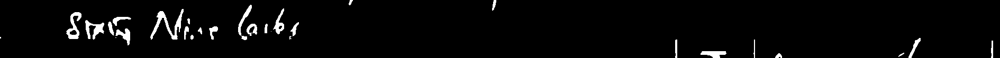

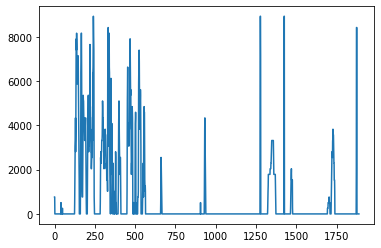

**


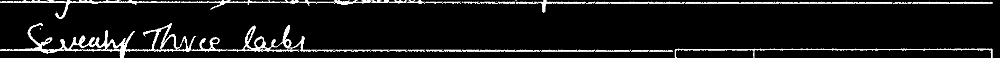

[1530, 1785, 765, 1020, 1020, 1020, 1020, 1020, 765, 765, 1020, 1020, 765, 1020, 765, 1020, 1020, 1020, 1020, 765, 1020, 1020, 1020, 1020, 1020, 510, 1020, 1020, 765, 1020, 765, 1020, 1020, 1020, 765, 1020, 1020, 1020, 1020, 1020, 765, 765, 1020, 765, 1275, 1530, 1530, 1530, 2040, 1785, 1530, 1530, 2040, 4080, 5100, 5865, 6630, 6375, 4080, 4080, 4590, 4080, 3570, 3315, 4335, 4080, 3825, 4590, 3825, 4845, 5100, 5865, 6120, 6120, 6120, 6120, 5865, 6120, 6885, 5100, 4335, 4590, 4590, 4590, 4590, 4590, 5355, 4590, 4335, 4080, 4080, 3315, 3570, 3315, 5610, 5610, 4590, 4590, 4080, 3060, 3060, 2805, 2040, 1530, 2805, 3315, 3570, 4590, 3315, 3060, 2550, 1785, 2550, 2550, 2550, 5610, 6885, 7650, 7650, 7395, 8160, 8415, 7395, 7140, 7395, 6375, 6375, 5100, 3825, 3060, 2805, 3315, 3570, 3570, 2295, 2295, 2805, 2805, 4335, 4590, 4845, 5100, 5610, 765, 765, 765, 765, 1020, 765, 3570, 4845, 5355, 6375, 7140, 6885, 4590, 5610, 5100, 5100, 3570, 2550, 1530, 1530, 1530, 1020, 1020, 765, 1530, 3315, 4335

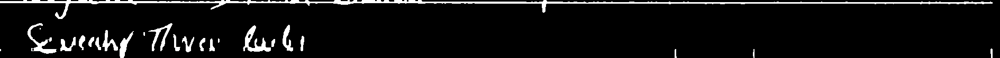

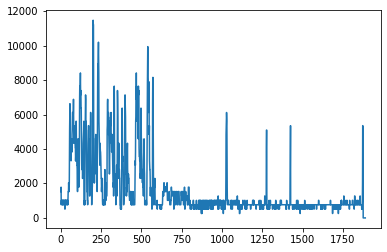

**


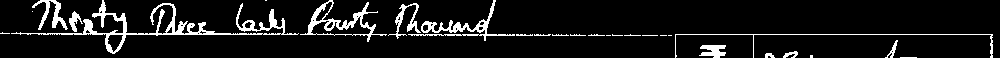

[765, 765, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 510, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 0, 0, 0, 0, 0, 0, 0, 1275, 1530, 1785, 1785, 2295, 2040, 1785, 1530, 1530, 1530, 1530, 1530, 2295, 3315, 3825, 4590, 4845, 5355, 5610, 5355, 5610, 5610, 5355, 4590, 4335, 6120, 7905, 8670, 7905, 7395, 6630, 6120, 5100, 3825, 2295, 510, 510, 765, 3825, 4590, 5610, 6630, 8670, 9945, 11985, 12495, 11985, 10965, 10200, 7905, 6885, 5610, 5610, 5610, 5100, 4590, 2805, 3315, 3570, 3570, 3825, 3825, 3315, 3060, 3060, 1530, 1275, 255, 0, 0, 1275, 2295, 3315, 3315, 3825, 4335, 5100, 8160, 9180, 9690, 9945, 8925, 8160, 7395, 7650, 5100, 2550, 2295, 2295, 2040, 2040, 1785, 1785, 1785, 1275, 510, 0, 2805, 3570, 5610, 7395, 7650, 7140, 5865, 5355, 5100, 4845, 5610, 6630, 6885, 7395, 7140, 6630, 7395, 6375, 3315, 3570, 4590, 4590, 4080, 3570, 3315, 3315, 3570, 2295, 1785, 1530, 2550, 4080, 3570, 8415, 10200, 12495, 13515, 13515, 1326

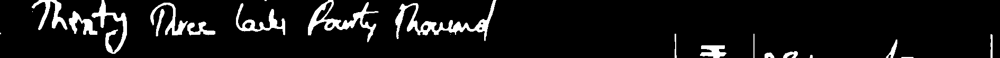

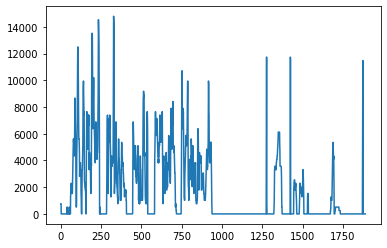

**


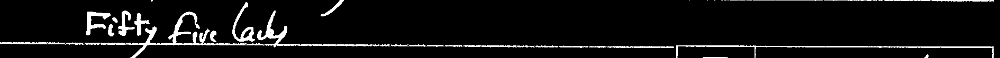

[765, 765, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1530, 11220, 11475, 11475, 11475, 11220, 11220, 10710, 8415, 5100, 3825, 3570, 3825, 3315, 3570, 3825, 3825, 3570, 3570, 3315, 3060, 3060, 3060, 3315, 3315, 3570, 3315, 3315, 3315, 3315, 3060, 4080, 4590, 4845, 5100, 4335, 3825, 2550, 2295, 2295, 2040, 3315, 5610, 6375, 6885, 6630, 5865, 5865, 3825, 3825, 3315, 2295, 1785, 2040, 2295, 2295, 2040, 1785, 1275, 255, 765, 2040, 2550, 3060, 3570, 4080, 3825, 6885, 11730, 11985, 11985, 11985, 12240, 7140, 5865, 5100, 3315, 3315, 3315, 5100, 5100, 4845, 45

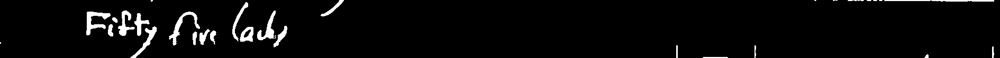

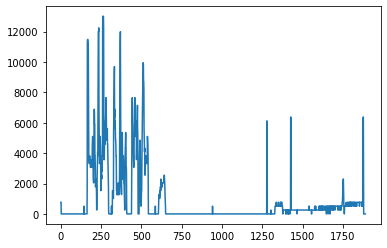

**


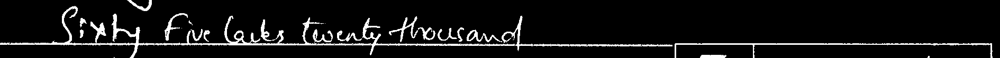

[765, 1020, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1020, 1530, 1530, 1020, 510, 510, 510, 510, 510, 0, 0, 0, 0, 0, 0, 0, 510, 0, 3570, 4845, 5865, 7395, 6120, 5100, 4590, 4335, 4845, 4590, 4590, 4845, 5355, 6120, 8160, 7140, 6120, 6120, 4590, 1785, 2550, 2295, 2550, 2805, 3825, 2805, 3825, 3315, 2550, 1530, 0, 0, 0, 0, 2805, 8160, 8415, 7395, 6120, 5610, 3060, 1530, 1785, 1530, 1275, 765, 255, 0, 0, 0, 0, 0, 0, 0, 2295, 2295, 2295, 2295, 2295, 2040, 2040, 2040, 1785, 4335, 6375, 6120, 4845, 5355, 4845, 3825, 3570, 4080, 5100, 5100, 5355, 5355, 4845, 5610, 5100, 4590, 3570, 1020, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 510, 510, 1020, 3315, 11730, 14025, 13005, 11475, 12240, 11730, 5865, 2040, 1785, 1530, 1275, 1275, 1020, 1020, 1275, 1020, 102

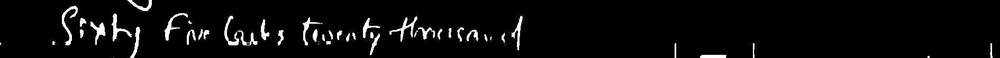

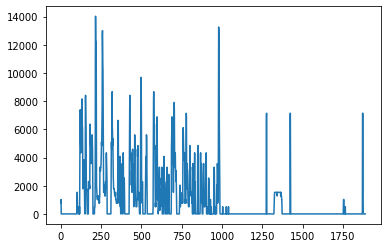

**


In [ ]:
from datetime import datetime

for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=240
      x=320
      h=110
      w=1900
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      cv2_imshow(image)
      # image = cv2.dilate(image,kernel,iterations = 1) 
      for i in range(60,image.shape[0]-10):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
              else:
                    image[i,j]=0              
      somme_columns=[]
      for column in image.T:
        somme_columns.append(np.sum(column)) 
      print(somme_columns)
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
      th3 = cv2.morphologyEx(th3, cv2.MORPH_CLOSE, kernel)
      # txt = pytesseract.image_to_string(th3, config="--psm 4")
      # print(correct(txt))
      cv2.imwrite("/content/"+dirNameDataPNG+"/"+infile,th3)
      cv2_imshow(th3)
      plt.plot(somme_columns)     
      plt.show() 
      print("**")
      cv2.waitKey(0) 

**result 1** Montant en *Chiffre*

In [ ]:
dirNameDataPNG = 'resultchiffre'
if not os.path.exists(dirNameDataPNG):
  os.mkdir(dirNameDataPNG)
  print("Directory " , dirNameDataPNG ,  " Created ")
else:    
  print("Directory " , dirNameDataPNG ,  " already exists")

Directory  resultchiffre  Created 


(110, 420)


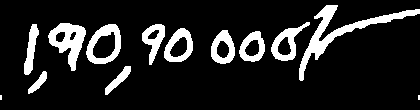

**
(110, 420)


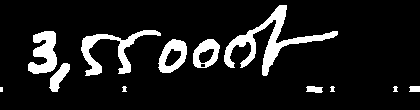

**
(110, 420)


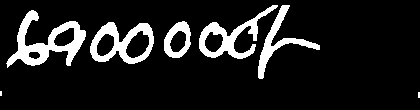

**
(110, 420)


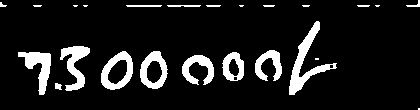

**
(110, 420)


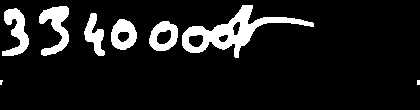

**
(110, 420)


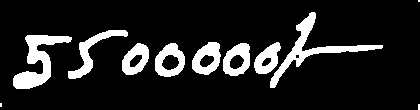

**
(110, 420)


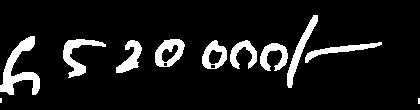

**


In [ ]:
from datetime import datetime

for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=330
      x=1760
      h=110
      w=420
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      image = cv2.dilate(image,kernel,iterations = 1) 
      print(image.shape)
      for i in range(0,image.shape[0]-105):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 :
                    image[i,j]=0

          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
                         
      for i in range(95,image.shape[0]):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 :
                    image[i,j]=0
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #   
      for i in range(60,image.shape[0]-10):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
              else:
                    image[i,j]=0  
      # somme_columns=[]
      # for column in image.T:
      #   somme_columns.append(np.sum(column)) 
      # print(somme_columns)           
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
      th3 = cv2.morphologyEx(th3, cv2.MORPH_CLOSE, kernel)
      # txt = pytesseract.image_to_string(th3, config="--psm 4")
      # print(correct(txt))
      cv2.imwrite("/content/"+dirNameDataPNG+"/"+infile,th3)
      cv2_imshow(th3)
      # plt.plot(somme_columns)     
      # plt.show() 
      # for i in range(len(somme_columns)-1):
      #   if (somme_columns[i]>500):
      #     a=i
      #     try:
      #       while(somme_columns[i]>500) :
      #         i+=1
      #     except IndexError:
      #       pass
      #     continue
      #     b=i
      #     image = image[y:y+h, a:b]
      #     cv2_imshow(image)

       
          
      print("**")
      cv2.waitKey(0) 

**Projection horizentale**

(110, 420)
[1275, 1275, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2805, 3315, 4335, 7395, 9435, 11730, 12240, 13005, 13770, 10965, 9180, 7395, 5865, 4335, 3825, 2805, 2805, 2805, 3060, 3060, 2805, 2550, 1530, 0, 765, 2550, 3315, 3825, 4080, 4335, 4590, 3825, 3570, 3315, 3570, 4845, 5100, 4845, 5355, 5610, 5610, 6630, 6885, 6375, 8670, 8670, 8670, 9690, 9435, 9690, 9945, 10200, 8925, 8415, 7650, 6630, 6120, 5610, 3825, 3570, 2295, 1275, 1020, 3060, 4080, 5100, 5610, 6120, 6630, 5100, 4590, 4590, 3825, 3825, 2805, 3315, 3315, 3060, 2550, 3060, 4080, 5355, 5610, 6375, 6630, 6630, 6885, 5865, 6120, 6630, 7395, 10965, 10455, 10200, 9180, 7905, 6120, 2550, 2805, 2805, 3315, 3315, 3060, 2805, 2295, 2040, 1020, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2040, 2550, 3060, 3570, 3825, 3825, 3570, 6120, 6630, 7140, 7140, 7395, 6630, 5865, 5865, 5610, 5355, 5355, 5100, 4590, 3825, 3315, 4590, 3060, 3825, 4335, 4845, 5610, 4845, 4590, 4335, 4080, 3570, 3825, 3825, 3825, 4590, 4080, 40

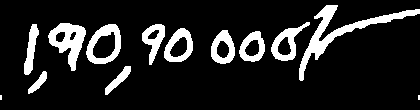

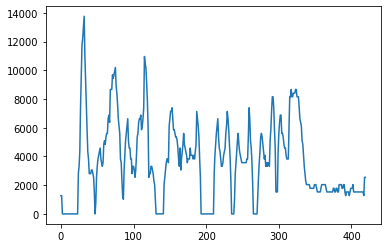

**
(110, 420)
[1275, 1275, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 2040, 2550, 3060, 3060, 3315, 6885, 7395, 7650, 7650, 7650, 7905, 7650, 7650, 7905, 7905, 7905, 8160, 8925, 9690, 10455, 10965, 10965, 12750, 13515, 13515, 13005, 12495, 10710, 7140, 4845, 4590, 4080, 4080, 4590, 4590, 4335, 4080, 3825, 3315, 3060, 2550, 1530, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 2040, 4335, 5610, 6120, 6885, 7905, 8160, 8670, 7395, 7140, 6885, 6630, 6630, 6630, 6120, 5865, 5610, 4845, 4590, 3825, 3060, 1530, 1530, 1785, 1785, 1785, 1785, 1530, 1530, 1785, 1785, 1785, 1530, 2040, 1785, 1785, 2040, 4845, 6120, 6885, 6885, 7905, 8670, 8670, 7395, 6375, 5865, 6120, 6120, 4335, 3315, 3060, 3060, 2040, 2040, 2040, 2040, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1530, 1785, 2040, 4590, 5355, 5100, 6120, 6630, 7140, 6375, 5355, 4845, 4590,

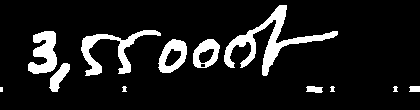

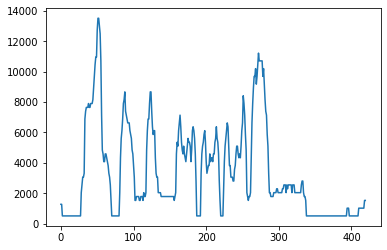

**
(110, 420)
[1275, 1275, 0, 0, 0, 510, 510, 1530, 2040, 2040, 2040, 2295, 2295, 2295, 2040, 2040, 2040, 3570, 6630, 7650, 8670, 9180, 10200, 10965, 11475, 9690, 9180, 8925, 7905, 7395, 6375, 6630, 6120, 6375, 5865, 5610, 5610, 5865, 4845, 4080, 4845, 5355, 5100, 5100, 4590, 4080, 3825, 3570, 4590, 3825, 4335, 4590, 5355, 5610, 4845, 4335, 3570, 3570, 3315, 3570, 3570, 3570, 3315, 3315, 3315, 3315, 5100, 6120, 6630, 7395, 7650, 6375, 6120, 6120, 8925, 8670, 7905, 7650, 6630, 6120, 4080, 3825, 3315, 2805, 2550, 1530, 0, 0, 0, 0, 1785, 3060, 4590, 5100, 5865, 6630, 6885, 5355, 4845, 4335, 4335, 4335, 4335, 3825, 4335, 4080, 3825, 3825, 5100, 5100, 5100, 5610, 5865, 5865, 7650, 7395, 6120, 4080, 3570, 1530, 2805, 4080, 4590, 5610, 6120, 6375, 6120, 5100, 5100, 4590, 3825, 3570, 3315, 3315, 3315, 3570, 3570, 3315, 3570, 3570, 3570, 3570, 3060, 4335, 4590, 5100, 5610, 5355, 6120, 7395, 6375, 5610, 4080, 2040, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3060, 4080, 4845, 5610, 6120, 6885, 6375, 5100, 459

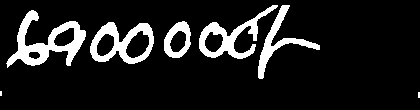

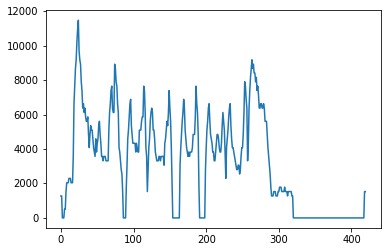

**
(110, 420)
[1275, 1275, 510, 510, 510, 510, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 1530, 1530, 1530, 1530, 1530, 1530, 1530, 2805, 3315, 3315, 3825, 3825, 4335, 4335, 4590, 3570, 3825, 3825, 3315, 3825, 4335, 7905, 8670, 9180, 10710, 10965, 10710, 9690, 8415, 6885, 6630, 4845, 3060, 255, 255, 255, 255, 1275, 1275, 1275, 765, 1275, 2040, 3315, 3570, 3060, 3060, 2805, 3315, 5100, 5865, 6630, 6885, 7395, 7140, 7140, 7650, 7140, 7650, 7395, 8415, 7905, 7650, 7140, 6375, 5610, 4080, 2805, 2805, 2295, 1785, 1530, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 2295, 4080, 4590, 5610, 5865, 6375, 5865, 5610, 4845, 4080, 4080, 3825, 3825, 3570, 3060, 2550, 3315, 3570, 3825, 3825, 4080, 4080, 4335, 4590, 5100, 5355, 8160, 7650, 7140, 5865, 5100, 3060, 510, 510, 510, 255, 510, 510, 510, 2040, 5100, 5865, 6375, 6630, 6885, 7140, 5355, 5355, 4335, 4080, 4080, 3825, 3570, 3825, 3570, 4335, 4845, 4845, 5865, 6630, 6120, 7140, 6630, 5865, 4590, 3570, 765, 510, 510, 510,

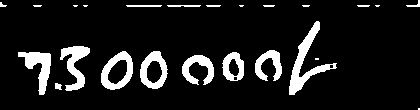

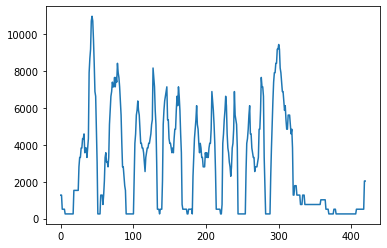

**
(110, 420)
[1020, 1275, 1785, 1785, 4080, 4845, 5610, 5865, 5610, 5610, 5865, 7395, 7140, 6630, 7140, 8160, 9180, 9945, 9180, 9945, 10710, 10710, 10455, 9180, 7395, 4845, 3825, 3570, 2295, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 2295, 3060, 4590, 5100, 5865, 5865, 5610, 4845, 4590, 4335, 4845, 4845, 5355, 6630, 7395, 7905, 8160, 8160, 8160, 8670, 9690, 9690, 10200, 10455, 9690, 8670, 7905, 7650, 6375, 4335, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 1530, 3570, 4335, 5355, 5865, 6630, 7650, 7650, 6885, 6375, 8415, 8670, 8160, 7140, 7395, 7395, 7140, 4845, 4845, 3825, 1530, 510, 510, 510, 510, 510, 510, 3060, 4590, 5610, 6120, 6630, 6885, 7395, 6630, 5865, 6120, 5865, 5865, 5610, 6120, 5865, 5865, 5610, 5865, 7140, 6885, 6375, 6120, 5610, 4590, 3570, 2295, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 510, 2040, 3315, 4590, 5100, 5865, 6375, 6630, 7140, 5865, 5100, 4845, 4845, 4845, 5100, 5100, 5100, 5355, 4845, 4845, 4845, 4080, 459

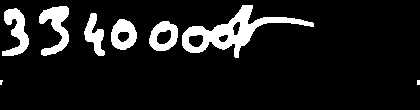

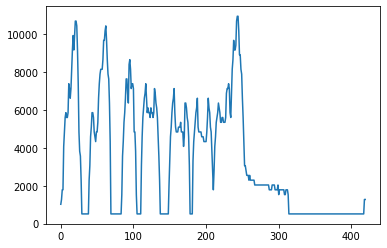

**
(110, 420)
[1020, 1020, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2040, 2805, 3315, 3570, 3825, 3825, 4080, 4080, 4080, 4335, 4335, 3825, 5100, 5865, 8415, 9945, 11730, 11475, 11475, 11475, 11220, 11220, 10965, 10200, 8160, 7905, 7395, 7140, 7395, 7905, 10455, 10455, 9945, 9690, 9180, 8415, 7650, 6375, 2295, 2295, 2295, 2040, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1530, 1530, 1530, 1785, 1785, 3315, 3315, 3315, 2805, 2040, 2040, 2040, 2295, 2040, 2040, 2295, 4080, 5865, 6375, 6885, 7395, 8415, 8670, 8670, 8415, 7650, 6630, 5610, 4845, 4080, 2295, 2040, 2040, 2040, 2040, 1785, 2040, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 1785, 2040, 1785, 1785, 1530, 1530, 1530, 1530, 1530, 1530, 1530, 1275, 1275, 1530, 1530, 4335, 4845, 6120, 6630, 6885, 6630, 6120, 5610, 4845, 4845, 4845, 4590, 4335, 4845, 5100, 5100, 5355, 5610, 6120, 5865, 5610, 6120, 5355, 5100, 4335, 3825, 2550, 0, 0, 0, 0, 0, 0, 3315, 4080, 4590, 5355, 5865, 6375, 6375, 5865, 5355, 5355, 4845, 4845, 4335, 4335, 4335, 4590, 

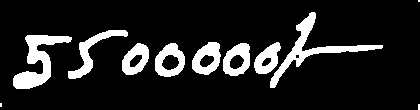

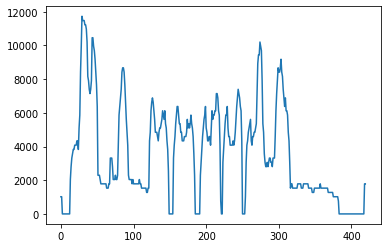

**
(110, 420)
[2295, 3060, 2040, 4590, 5355, 6120, 6885, 8415, 8925, 9690, 9435, 8925, 7650, 7395, 5610, 5355, 4845, 4590, 4335, 4335, 4845, 4080, 4080, 4590, 4845, 5100, 5100, 5355, 5610, 5610, 5355, 5100, 5610, 7395, 7905, 5610, 5100, 4335, 3825, 2550, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1785, 3825, 5355, 5865, 6375, 6885, 7140, 6630, 5610, 5100, 4845, 4590, 5355, 5610, 5865, 5610, 5100, 4335, 4080, 3825, 3825, 2805, 2805, 1785, 1275, 1275, 1275, 1275, 1275, 1275, 1530, 1275, 1275, 1275, 1275, 1020, 1020, 1020, 1020, 1020, 765, 765, 765, 0, 0, 0, 0, 0, 0, 0, 0, 0, 510, 1020, 1020, 1530, 1530, 2040, 2295, 2295, 2550, 2805, 3825, 4335, 4590, 5100, 5100, 5355, 5100, 5355, 5610, 5610, 5865, 5865, 5610, 4335, 3825, 2805, 1275, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2805, 3570, 4335, 4590, 5355, 5610, 5100, 3060, 3315, 2805, 2550, 2550, 3060, 3825, 4080, 4590, 5355, 3825, 3570, 3570, 3570, 3825, 3825, 4335, 5100, 4335, 3825, 3315, 1785, 765, 0, 0, 0, 0, 0, 

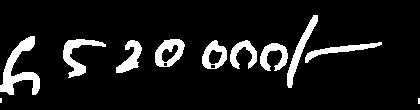

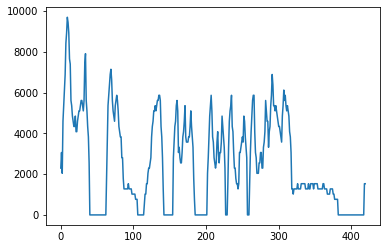

**


In [ ]:
from datetime import datetime

for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=330
      x=1760
      h=110
      w=420
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      image = cv2.dilate(image,kernel,iterations = 1) 
      print(image.shape)
      for i in range(0,image.shape[0]-105):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 :
                    image[i,j]=0

          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
                         
      for i in range(95,image.shape[0]):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 :
                    image[i,j]=0
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #   
      for i in range(60,image.shape[0]-10):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
              else:
                    image[i,j]=0  
      somme_columns=[]
      for column in image.T:
        somme_columns.append(np.sum(column)) 
      print(somme_columns)           
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
      th3 = cv2.morphologyEx(th3, cv2.MORPH_CLOSE, kernel)
      # txt = pytesseract.image_to_string(th3, config="--psm 4")
      # print(correct(txt))
      cv2.imwrite("/content/"+dirNameDataPNG+"/"+infile,th3)
      cv2_imshow(th3)
      plt.plot(somme_columns)     
      plt.show() 
      # for i in range(len(somme_columns)-1):
      #   if (somme_columns[i]>500):
      #     a=i
      #     try:
      #       while(somme_columns[i]>500) :
      #         i+=1
      #     except IndexError:
      #       pass
      #     continue
      #     b=i
      #     image = image[y:y+h, a:b]
      #     cv2_imshow(image)

       
          
      print("**")
      cv2.waitKey(0) 

**Divide image**

[1275, 1275, 1275, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1785, 2040, 2550, 2550, 2805, 6375, 6885, 7140, 7140, 7140, 7395, 7140, 7140, 7395, 7395, 7650, 8415, 8670, 9945, 10455, 10455, 10710, 13260, 13770, 14280, 13515, 12495, 10965, 7140, 5355, 4845, 3825, 3825, 4080, 4080, 3825, 3570, 3315, 2805, 2550, 2040, 1530, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1020, 3315, 4590, 5100, 6375, 7905, 8160, 8670, 7905, 7140, 6885, 7140, 6630, 6120, 5610, 5355, 5100, 4335, 4080, 3315, 3060, 1275, 1275, 1275, 1275, 1275, 1275, 1020, 1020, 1275, 1275, 1275, 1020, 1020, 765, 765, 1020, 4335, 6120, 7395, 7395, 8415, 10200, 9180, 8160, 6630, 5610, 5610, 5610, 4335, 2550, 2550, 2550, 1785, 1530, 1530, 1530, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1275, 1020, 1275, 1530, 4080, 4845, 4590, 5610, 6120, 6630, 6375, 5610, 5100, 4845, 4845, 4335, 4080, 4335, 4335, 4845, 5100, 4845, 5100, 5100, 5100, 5355, 6120, 5865, 5

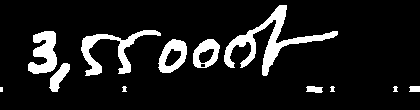

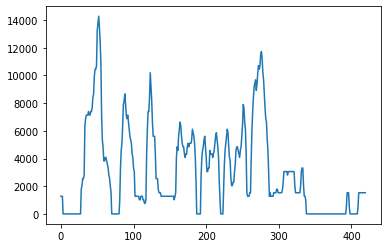

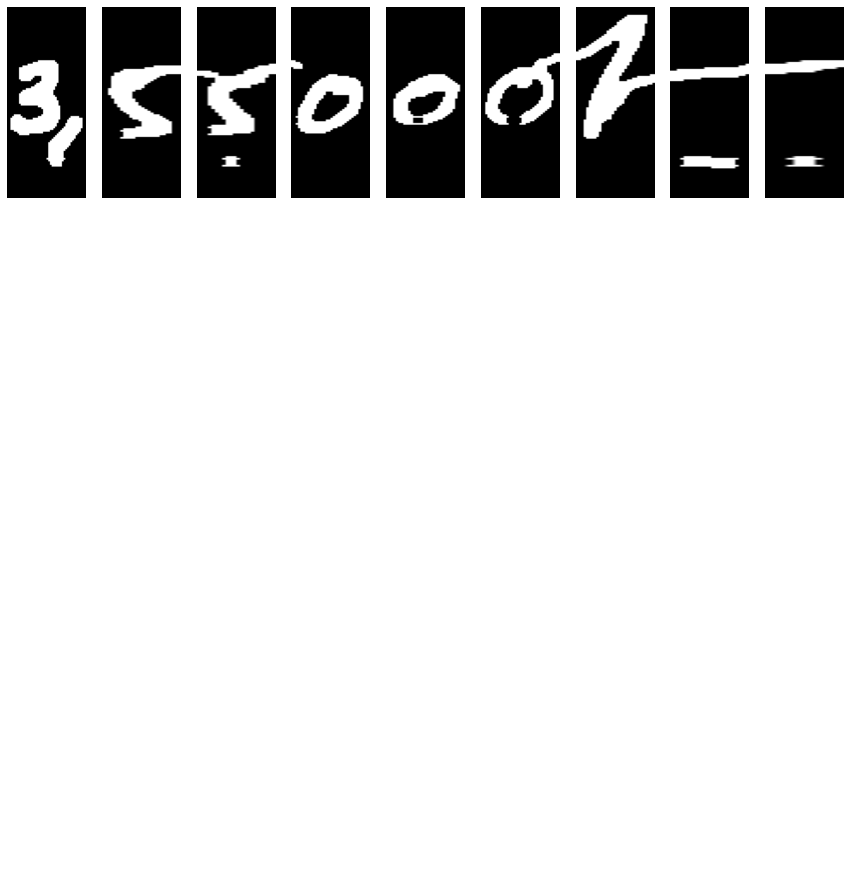

In [ ]:
th3 = imread("/content/resultchiffre/Cheque 120613.png")
somme_columns=[]
for column in th3.T:
        somme_columns.append(np.sum(column)) 
print(somme_columns)
cv2_imshow(th3)
plt.plot(somme_columns)     
plt.show() 
i=4
s=0
l=[]
try:
  while (i< len(somme_columns)-4):
    if (somme_columns[i]>2000):
          s+=1
          a=i
          while(somme_columns[i]>2000) :
              i+=1
          b=i
          crop = th3[0:h, a-3:b+3]
          # cv2_imshow(crop)
          l.append(crop)
    i+=1 
except IndexError:
      pass
fig, axes = plt.subplots(1, len(l), figsize=(15, 16))
ax = axes.ravel()
for i in range(len(l)):
  ax[i].imshow(l[i], cmap="gray",aspect="auto")
  ax[i].set_axis_off()
  ax[i].set_ylim(500, 0)



   


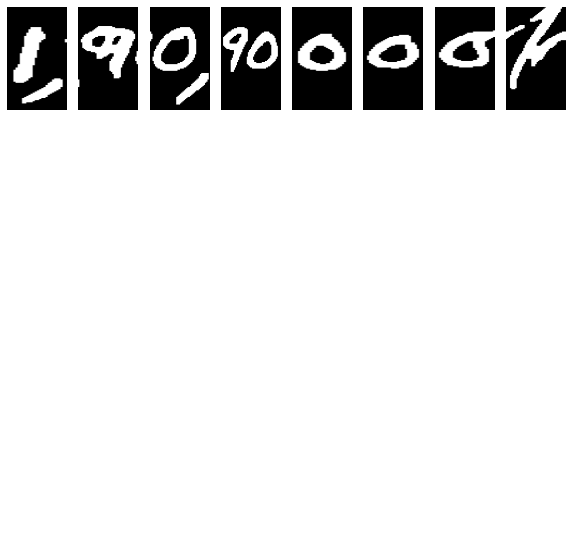

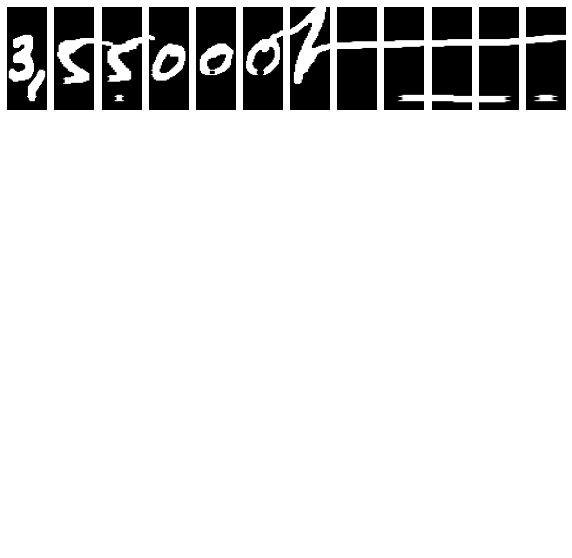

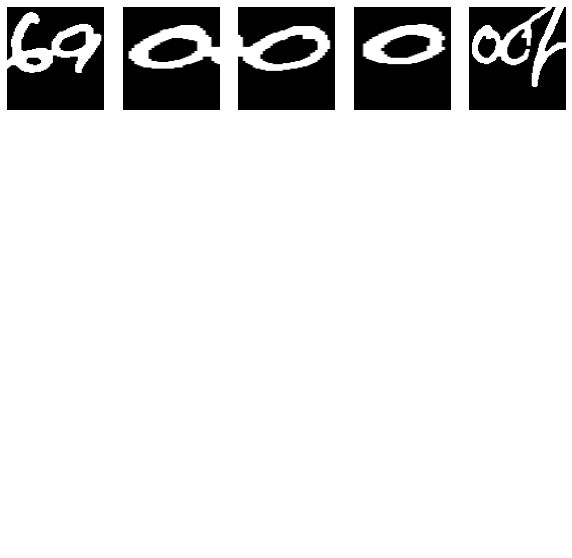

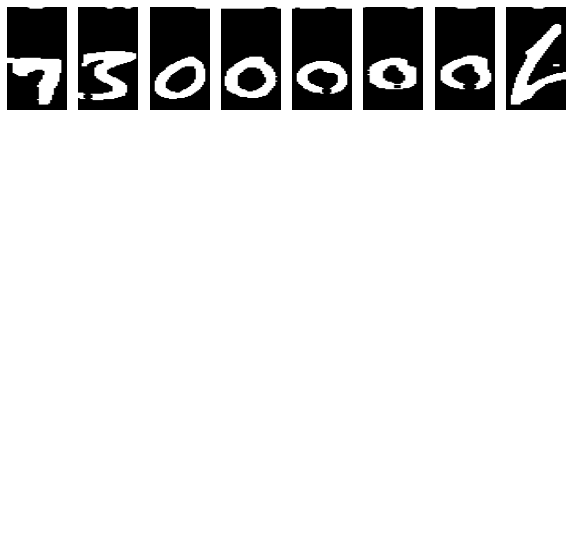

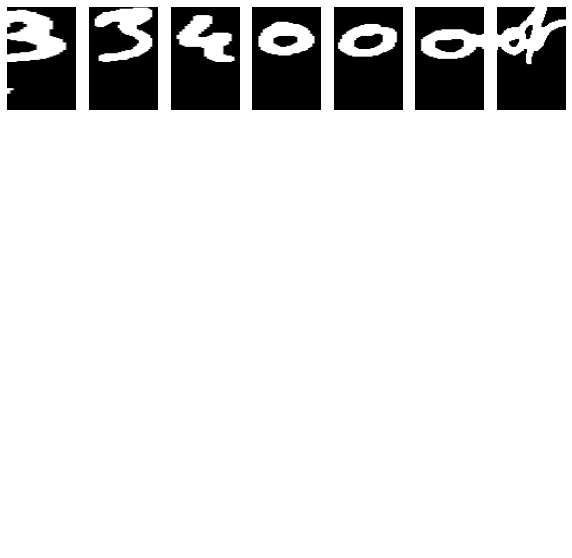

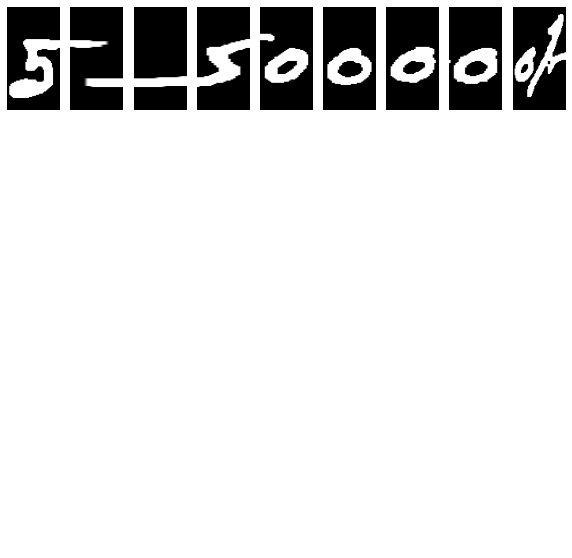

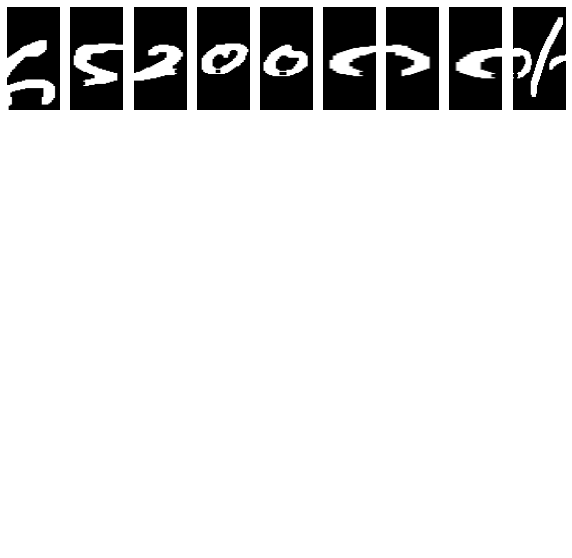

In [ ]:
from datetime import datetime

for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=330
      x=1770
      h=110
      w=420
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      image = cv2.dilate(image,kernel,iterations = 1) 
      for i in range(0,image.shape[0]-105):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 :
                    image[i,j]=0

          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
                         
      for i in range(95,image.shape[0]):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 :
                    image[i,j]=0
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #   
      for i in range(60,image.shape[0]-10):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
              else:
                    image[i,j]=0  
      
      somme_columns=[]
      for column in image.T:
        somme_columns.append(np.sum(column)) 
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
      th3 = cv2.morphologyEx(th3, cv2.MORPH_CLOSE, kernel)
      cv2.imwrite("/content/"+dirNameDataPNG+"/"+infile,th3)
      i=4
      l=[]
      try:
        while (i< len(somme_columns)-4):
          if (somme_columns[i]>2200):
                a=i
                while(somme_columns[i]>2200) :
                    i+=1
                b=i
                crop = th3[5:100, a-3:b+3]
                # cv2_imshow(crop)
                l.append(crop)
          i+=1 
      except IndexError:
        pass
      fig, axes = plt.subplots(1, len(l), figsize=(10, 10))
      ax = axes.ravel()
      for i in range(len(l)):
           ax[i].imshow(l[i], cmap="gray",aspect="auto")
           ax[i].set_axis_off()
           ax[i].set_ylim(500,0)

       
          


In [ ]:
new_path1 = "/content/resultchiffre/"

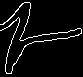

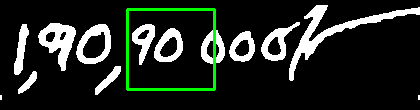

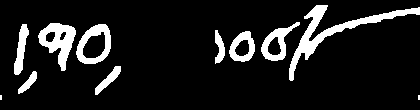

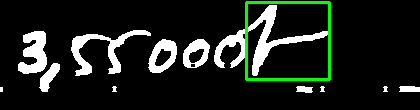

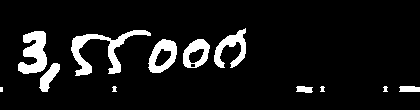

...

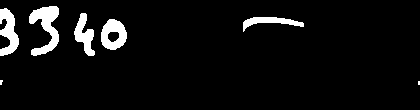

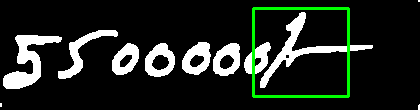

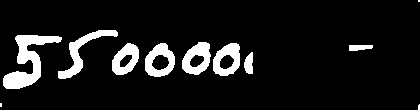

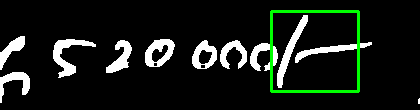

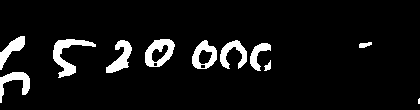

In [ ]:
import cv2
import numpy as np

def  maintain_aspect_ratio_resize(image,  width=None,  height=None,  inter=cv2.INTER_AREA):
     dim =  None
     (h, w)  = image.shape[:2]
     if width is  None  and height is  None:
        return image

     if width is  None:
        r = height /  float(h)
        dim =  (int(w * r), height)
     else:
          r = width /  float(w)
          dim =  (width,  int(h * r))

          return cv2.resize(image, dim,  interpolation=inter)
template = cv2.imread('template.png')
template = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)
template = cv2.Canny(template,  50,  200)
(tH, tW)  = template.shape[:2]
cv2_imshow(template)
from datetime import datetime

for infile in os.listdir(new_path1):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path1+infile)
      final = image.copy()
      gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
      found =  None

      for scale in np.linspace(0.2,  1.0,  20)[::-1]:
          resized = maintain_aspect_ratio_resize(gray,  width=int(gray.shape[1]  * scale))
          r = gray.shape[1]  /  float(resized.shape[1])

          if resized.shape[0]  < tH or resized.shape[1]  < tW:
              break
          canny = cv2.Canny(resized,  50,  200)
          detected = cv2.matchTemplate(canny, template, cv2.TM_CCOEFF)
          (_, max_val, _, max_loc)  = cv2.minMaxLoc(detected)

          if found is  None  or max_val > found[0]:
              found =  (max_val, max_loc, r)

      (_, max_loc, r)  = found
      (start_x, start_y)  =  (int(max_loc[0]  * r),  int(max_loc[1]  * r))
      (end_x, end_y)  =  (int((max_loc[0]  + tW)  * r),  int((max_loc[1]  + tH)  * r))


      cv2.rectangle(image,  (start_x, start_y),  (end_x, end_y),  (0,255,0),  2)
      cv2_imshow(image)

      cv2.rectangle(final,  (start_x, start_y),  (end_x, end_y),  (0,0,0),  -1)
      cv2_imshow(final)
      cv2.imwrite("/content/"+dirNameDataPNG+"/"+infile,final)
      cv2.waitKey(0)

In [ ]:
base_path = "/content/resultchiffre/"
new_path = "/content/resultchiffre/"
for infile in os.listdir(base_path):
  if not "ipynb_checkpoints" in infile:
    print ("file : " + infile)
    read = cv2.imread(base_path + infile)
    outfile = infile.split('.')[0] + '.png'
    cv2.imwrite("/content/"+dirNameDataPNG+"/"+outfile,read,[int(cv2.IMWRITE_JPEG_QUALITY), 200])

file : Cheque 120617.png
file : Cheque 120613.png
file : Cheque 120614.png
file : Cheque 120612.png
file : Cheque 120615.png
file : Cheque 120616.png
file : Cheque 120611.png


The Shape of the image is: (110, 420)
The image as array is:
[[0. 0. 0. ... 0. 1. 1.]
 [0. 0. 0. ... 0. 1. 1.]
 [1. 1. 0. ... 0. 1. 1.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[4.0, 4.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0, 14.0, 14.0, 15.0, 16.0, 17.0, 17.0, 17.0, 17.0, 15.0, 15.0, 15.0, 14.0, 13.0, 16.0, 34.0, 35.0, 39.0, 42.0, 42.0, 41.0, 38.0, 33.0, 27.0, 25.0, 21.0, 12.0, 0.0, 0.0, 0.0, 0.0, 6.0, 6.0, 6.0, 5.0, 6.0, 9.0, 13.0, 11.0, 10.0, 9.0, 10.0, 14.0, 21.0, 26.0, 27.0, 28.0, 30.0, 34.0, 36.0, 34.0, 34.0, 33.0, 36.0, 33.0, 31.0, 29.0, 27.0, 25.0, 24.0, 19.0, 11.0, 11.0, 9.0, 6.0, 5.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 10.0, 15.0, 18.0, 21.0, 23.0, 24.0, 26.0, 22.0, 20.0, 19.0, 17.0, 16.0, 16.0, 15.0, 14.0, 13.0, 14.0, 15.0, 16.0, 15.0, 16.0, 17.0, 18.0, 19.0, 19.0, 23.0, 32.0, 30.0, 28.0, 25.0, 21.0, 14.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 11.0, 20.0, 23.0, 25.0, 27.0, 29.0, 31.0, 23.0, 2

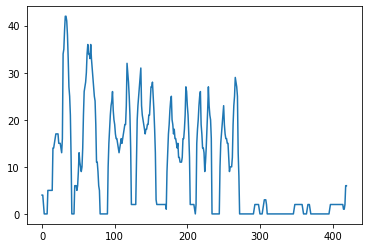

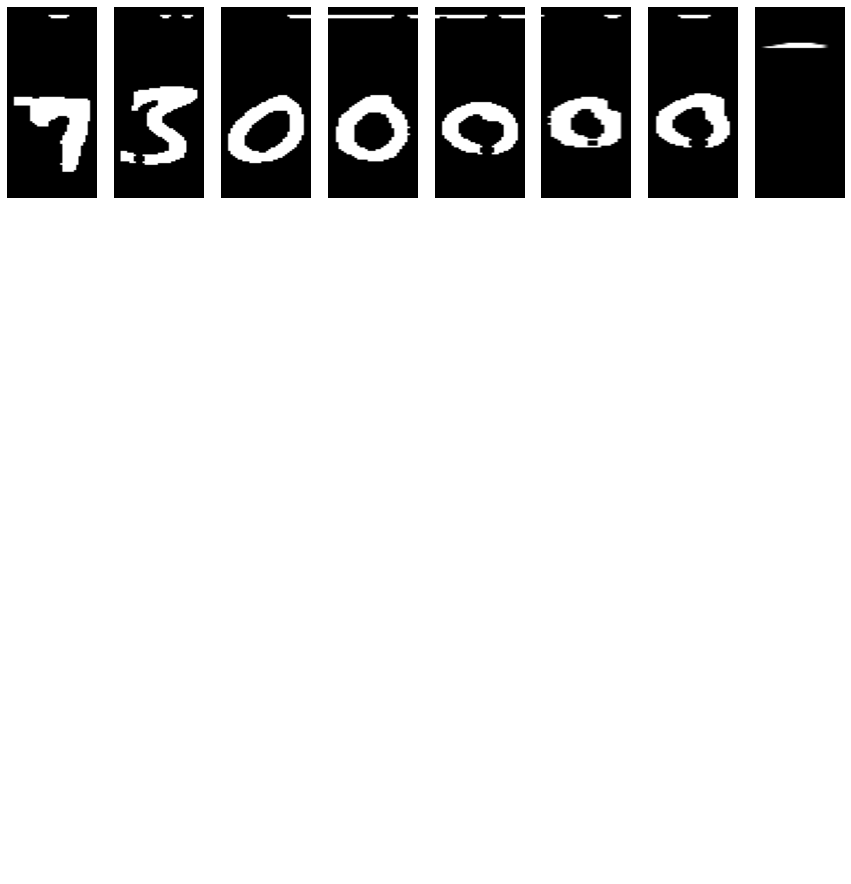

In [ ]:
import matplotlib.image as image
def cut(pathh):
  th3=image.imread(pathh)
  th3=cv2.cvtColor(th3,cv2.COLOR_BGR2GRAY)
  print('The Shape of the image is:',th3.shape)
  print('The image as array is:')
  print(th3)
  somme_columns=[]
  for column in th3.T:
        somme_columns.append(np.sum(column)) 
  print(somme_columns)
  plt.plot(somme_columns)     
  plt.show() 
  i=4
  s=0
  l=[]
  try:
    while (i< len(somme_columns)-4):
       if (somme_columns[i]>2.0):
          s+=1
          a=i
          while(somme_columns[i]>2.0) :
              i+=1
          b=i
          crop = th3[0:h, a-3:b+3]
          # cv2_imshow(crop)
          l.append(crop)
       i+=1 
  except IndexError:
      pass
  fig, axes = plt.subplots(1, len(l), figsize=(15, 16))
  ax = axes.ravel()
  for i in range(len(l)):
    ax[i].imshow(l[i], cmap="gray",aspect="auto")
    ax[i].set_axis_off()
    ax[i].set_ylim(500, 0)
cut("/content/resultchiffre/Cheque 120612.png")

# Chèque catégorie 2 

In [ ]:
dirNameDataPNG = 'dataPNG1'
if not os.path.exists(dirNameDataPNG):
  os.mkdir(dirNameDataPNG)
  print("Directory " , dirNameDataPNG ,  " Created ")
else:    
  print("Directory " , dirNameDataPNG ,  " already exists")

Directory  dataPNG1  Created 


In [ ]:
base_path = "/content/gdrive/MyDrive/green/"
new_path = "/content/dataPNG1/"
for infile in os.listdir(base_path):
  if not "ipynb_checkpoints" in infile:
    print ("file : " + infile)
    read = cv2.imread(base_path + infile)
    outfile = infile.split('.')[0] + '.png'
    cv2.imwrite("/content/"+dirNameDataPNG+"/"+outfile,read,[int(cv2.IMWRITE_JPEG_QUALITY), 200])

file : Cheque 083654 (1).tif
file : Cheque 083654.tif
file : Cheque 083655 (1).tif
file : Cheque 083655.tif
file : Cheque 083656 (1).tif
file : Cheque 083656.tif
file : Cheque 083657 (1).tif
file : Cheque 083657.tif
file : Cheque 083658 (1).tif
file : Cheque 083658.tif
file : Cheque 083659 (1).tif
file : Cheque 083659.tif
file : Cheque 083660 (1).tif
file : Cheque 083660.tif


In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      image = cv2.imread(new_path+infile)
      resized = cv2.resize(image, (2300,1000),)
      cv2.imwrite(new_path+infile,resized)
      print(resized.shape)
      
      print("")

file : Cheque 083654.png
(1000, 2300, 3)

file : Cheque 083656 (1).png
(1000, 2300, 3)

file : Cheque 083657 (1).png
(1000, 2300, 3)

file : Cheque 083655 (1).png
(1000, 2300, 3)

file : Cheque 083660 (1).png
(1000, 2300, 3)

file : Cheque 083656.png
(1000, 2300, 3)

file : Cheque 083655.png
(1000, 2300, 3)

file : Cheque 083659 (1).png
(1000, 2300, 3)

file : Cheque 083659.png
(1000, 2300, 3)

file : Cheque 083654 (1).png
(1000, 2300, 3)

file : Cheque 083657.png
(1000, 2300, 3)

file : Cheque 083660.png
(1000, 2300, 3)

file : Cheque 083658 (1).png
(1000, 2300, 3)

file : Cheque 083658.png
(1000, 2300, 3)



In [ ]:
def center_crop(im, crop_pixels = 45):
    return im[crop_pixels:im.shape[0] - crop_pixels*3, crop_pixels:im.shape[1] - crop_pixels]

In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      im = Image.open(new_path+infile)
      image = cv2.imread(new_path+infile)
      cropped = center_crop(image)
      cv2.imwrite(new_path+infile,cropped)
      print(cropped.shape)
      
      print("")

file : Cheque 083654.png
(820, 2210, 3)

file : Cheque 083656 (1).png
(820, 2210, 3)

file : Cheque 083657 (1).png
(820, 2210, 3)

file : Cheque 083655 (1).png
(820, 2210, 3)

file : Cheque 083660 (1).png
(820, 2210, 3)

file : Cheque 083656.png
(820, 2210, 3)

file : Cheque 083655.png
(820, 2210, 3)

file : Cheque 083659 (1).png
(820, 2210, 3)

file : Cheque 083659.png
(820, 2210, 3)

file : Cheque 083654 (1).png
(820, 2210, 3)

file : Cheque 083657.png
(820, 2210, 3)

file : Cheque 083660.png
(820, 2210, 3)

file : Cheque 083658 (1).png
(820, 2210, 3)

file : Cheque 083658.png
(820, 2210, 3)



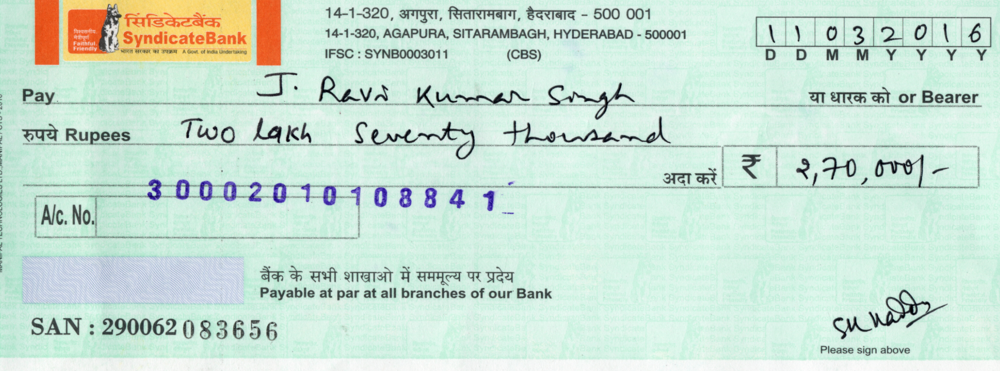

In [ ]:
image1 = cv2.imread("/content/dataPNG1/Cheque 083656.png")
cv2_imshow(image1)


In [ ]:
def inverte(imagem, name):
    imagem = (255-imagem)
    cv2.imwrite(name, imagem)

## result2

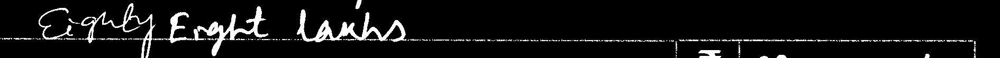

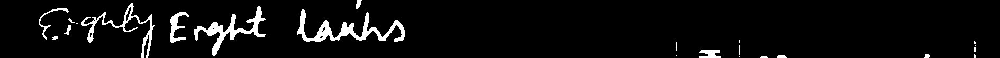

**


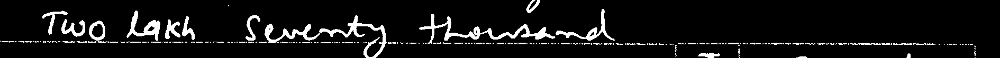

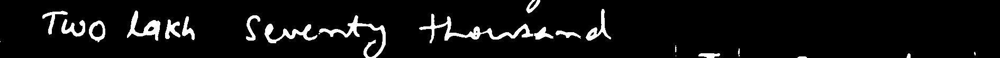

**


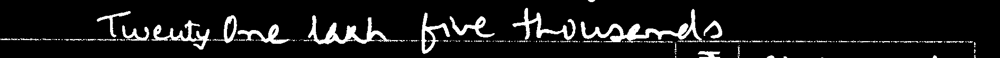

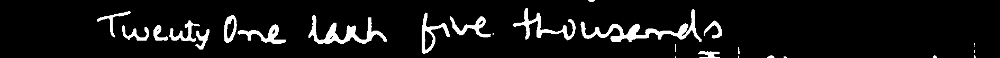

**


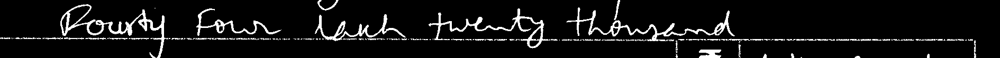

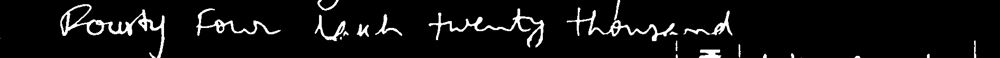

**


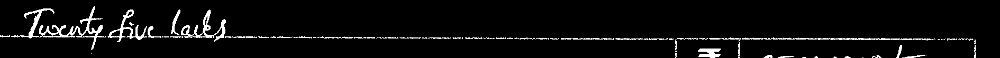

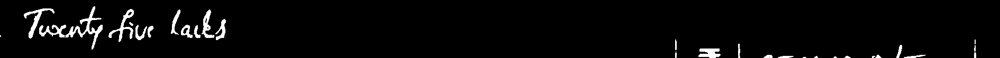

**


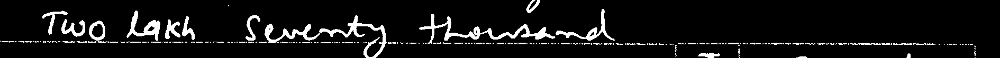

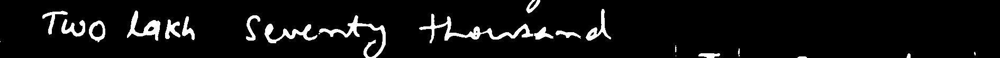

**


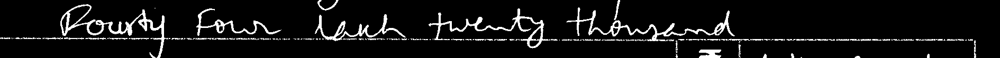

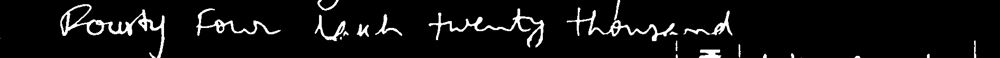

**


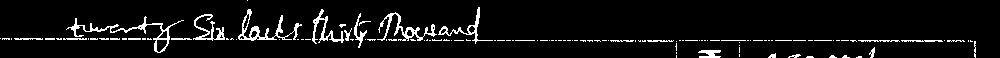

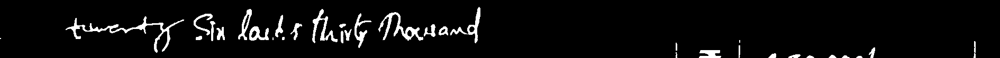

**


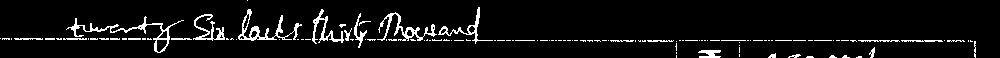

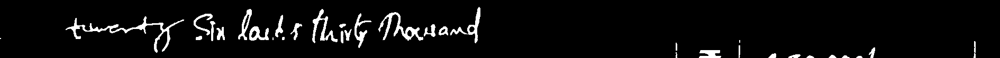

**


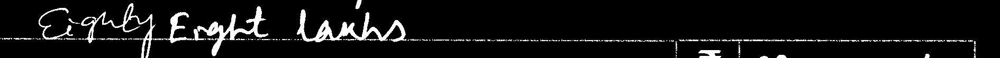

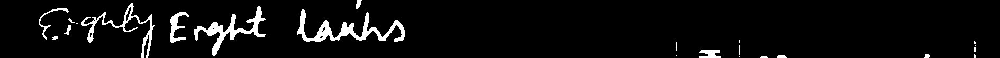

**


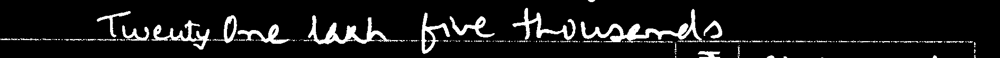

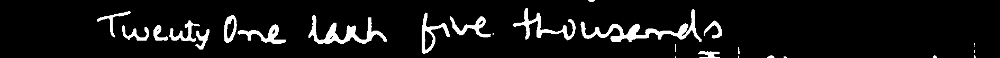

**


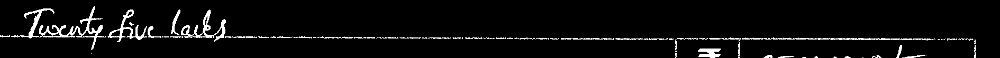

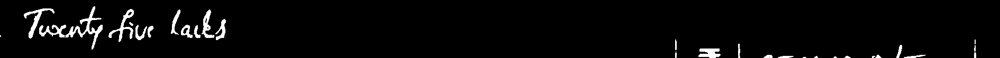

**


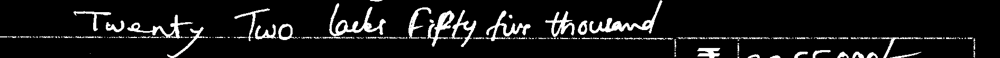

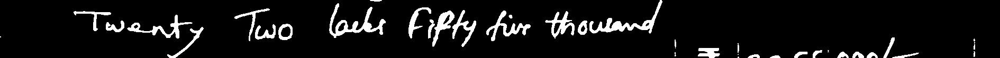

**


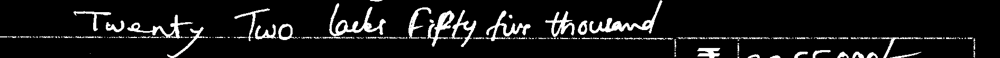

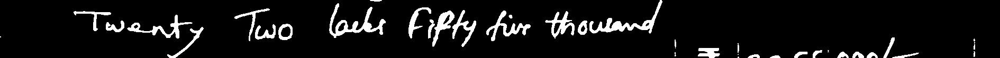

**


In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=240
      x=320
      h=110
      w=1900
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      cv2_imshow(image)
      # image = cv2.dilate(image,kernel,iterations = 1) 
      for i in range(65,image.shape[0]-10):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-3,j]==255 or image[i+3,j]==255):
                    image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
              else:
                    image[i,j]=0
      # for i in range(60,image.shape[0]-10):
      #     for j in range(2,image.shape[1]-2):
      #         for z in range(1,5):
      #            if image[i,j]==0 and (image[i-z,j]==255 and image[i+z,j]==255):
      #               image[i,j]=255   
      #            elif image[i,j]==255 and (image[i-3,j]==255 or image[i+3,j]==255):
      #               image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
                #  else:
                #     image[i,j]=0
     
      # for i in range(60,image.shape[0]-5):
      #     for j in range(2,image.shape[1]-2):
      #             if image[i,j]==0 and ((image[i-3,j]==255 and image[i+3,j]==255) or (image[i,j+2]==255 and image[i,j-2]==255)):
      #               image[i,j]=255   
      #closing = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel) 
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
 
      cv2_imshow(th3)
      print("**")
      cv2.waitKey(0) 


# Chèque catégorie 3 

In [ ]:
dirNameDataPNG = 'dataPNG2'
if not os.path.exists(dirNameDataPNG):
  os.mkdir(dirNameDataPNG)
  print("Directory " , dirNameDataPNG ,  " Created ")
else:    
  print("Directory " , dirNameDataPNG ,  " already exists")

Directory  dataPNG2  Created 


In [ ]:
base_path = "/content/gdrive/MyDrive/yellow/"
new_path = "/content/dataPNG2/"
for infile in os.listdir(base_path):
  if not "ipynb_checkpoints" in infile:
    print ("file : " + infile)
    read = cv2.imread(base_path + infile)
    outfile = infile.split('.')[0] + '.png'
    cv2.imwrite("/content/"+dirNameDataPNG+"/"+outfile,read,[int(cv2.IMWRITE_JPEG_QUALITY), 200])

file : Cheque 309061.tif
file : Cheque 309062.tif
file : Cheque 309063.tif
file : Cheque 309066.tif
file : Cheque 309067.tif
file : Cheque 309068.tif
file : Cheque 309069.tif
file : Cheque 309070.tif
file : Cheque 309071.tif
file : Cheque 309072.tif
file : Cheque 309073.tif
file : Cheque 309074.tif
file : Cheque 309075.tif
file : Cheque 309076.tif
file : Cheque 309077.tif
file : Cheque 309078.tif
file : Cheque 309079.tif
file : Cheque 309080.tif
file : Cheque 309082.tif
file : Cheque 309083.tif
file : Cheque 309084.tif
file : Cheque 309086.tif
file : Cheque 309089.tif
file : Cheque 309090.tif
file : Cheque 309091.tif
file : Cheque 309092.tif
file : Cheque 309093.tif
file : Cheque 309094.tif
file : Cheque 309095.tif
file : Cheque 309096.tif
file : Cheque 309097.tif
file : Cheque 309098.tif
file : Cheque 309099.tif
file : Cheque 309100.tif
file : Cheque 309101.tif
file : Cheque 309102 (1).tif
file : Cheque 309102.tif
file : Cheque 309103.tif
file : Cheque 309104.tif
file : Cheque 309105.

In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      image = cv2.imread(new_path+infile)
      resized = cv2.resize(image, (2300,1000),)
      cv2.imwrite(new_path+infile,resized)
      print(resized.shape)
      
      print("")

file : Cheque 309157.png
(1000, 2300, 3)

file : Cheque 309098.png
(1000, 2300, 3)

file : Cheque 309114.png
(1000, 2300, 3)

file : Cheque 309131.png
(1000, 2300, 3)

file : Cheque 309099.png
(1000, 2300, 3)

file : Cheque 309100.png
(1000, 2300, 3)

file : Cheque 309158.png
(1000, 2300, 3)

file : Cheque 309126.png
(1000, 2300, 3)

file : Cheque 309084.png
(1000, 2300, 3)

file : Cheque 309063.png
(1000, 2300, 3)

file : Cheque 309104.png
(1000, 2300, 3)

file : Cheque 309145.png
(1000, 2300, 3)

file : Cheque 309135.png
(1000, 2300, 3)

file : Cheque 309067.png
(1000, 2300, 3)

file : Cheque 309086.png
(1000, 2300, 3)

file : Cheque 309123.png
(1000, 2300, 3)

file : Cheque 309125.png
(1000, 2300, 3)

file : Cheque 309153.png
(1000, 2300, 3)

file : Cheque 309122.png
(1000, 2300, 3)

file : Cheque 309111.png
(1000, 2300, 3)

file : Cheque 309109.png
(1000, 2300, 3)

file : Cheque 309118.png
(1000, 2300, 3)

file : Cheque 309083.png
(1000, 2300, 3)

file : Cheque 309090.png
(1000, 23

In [ ]:
def center_crop(im, crop_pixels = 45):
    return im[crop_pixels:im.shape[0] - crop_pixels*3, crop_pixels:im.shape[1] - crop_pixels]

In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      im = Image.open(new_path+infile)
      image = cv2.imread(new_path+infile)
      cropped = center_crop(image)
      cv2.imwrite(new_path+infile,cropped)
      print(cropped.shape)
      
      print("")

file : Cheque 309157.png
(820, 2210, 3)

file : Cheque 309098.png
(820, 2210, 3)

file : Cheque 309114.png
(820, 2210, 3)

file : Cheque 309131.png
(820, 2210, 3)

file : Cheque 309099.png
(820, 2210, 3)

file : Cheque 309100.png
(820, 2210, 3)

file : Cheque 309158.png
(820, 2210, 3)

file : Cheque 309126.png
(820, 2210, 3)

file : Cheque 309084.png
(820, 2210, 3)

file : Cheque 309063.png
(820, 2210, 3)

file : Cheque 309104.png
(820, 2210, 3)

file : Cheque 309145.png
(820, 2210, 3)

file : Cheque 309135.png
(820, 2210, 3)

file : Cheque 309067.png
(820, 2210, 3)

file : Cheque 309086.png
(820, 2210, 3)

file : Cheque 309123.png
(820, 2210, 3)

file : Cheque 309125.png
(820, 2210, 3)

file : Cheque 309153.png
(820, 2210, 3)

file : Cheque 309122.png
(820, 2210, 3)

file : Cheque 309111.png
(820, 2210, 3)

file : Cheque 309109.png
(820, 2210, 3)

file : Cheque 309118.png
(820, 2210, 3)

file : Cheque 309083.png
(820, 2210, 3)

file : Cheque 309090.png
(820, 2210, 3)

file : Cheque 30

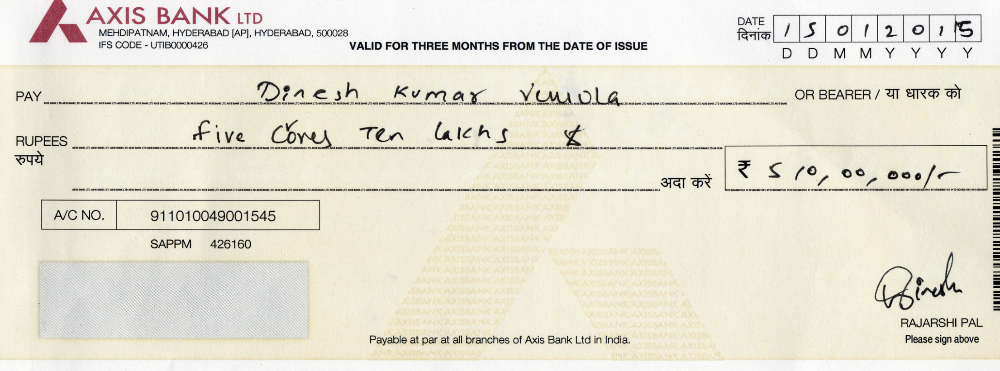

In [ ]:
image1 = cv2.imread("/content/dataPNG2/Cheque 309061.png")
cv2_imshow(image1)

## result3

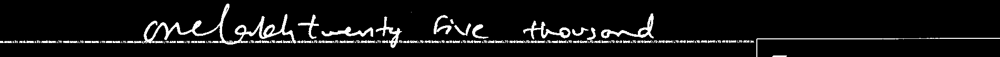

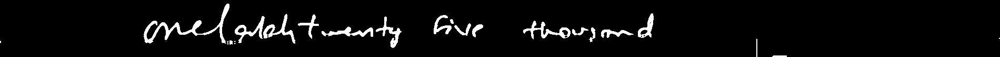

**


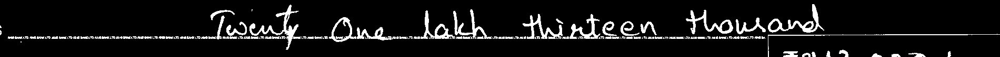

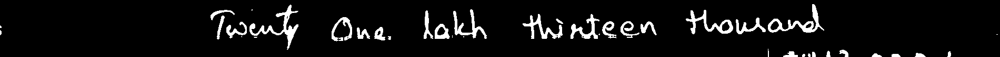

**


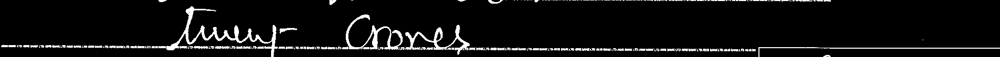

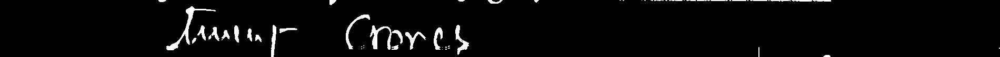

**


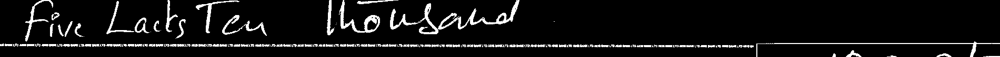

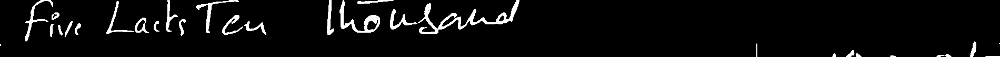

**


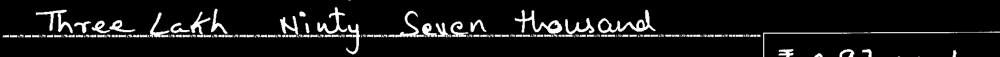

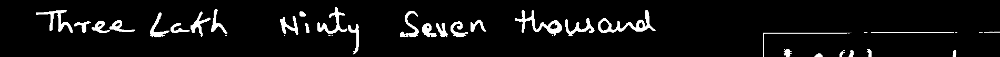

**


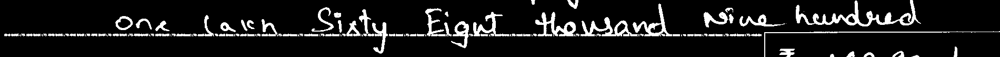

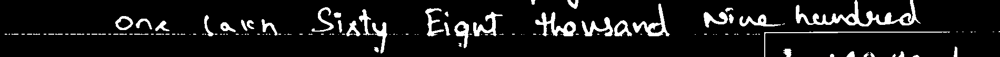

**


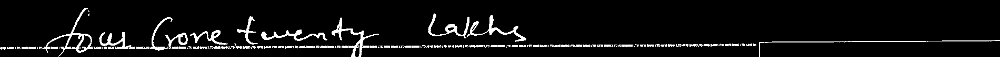

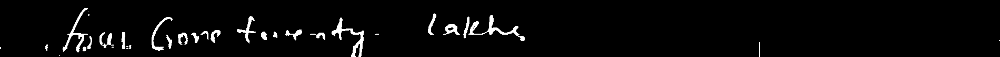

**


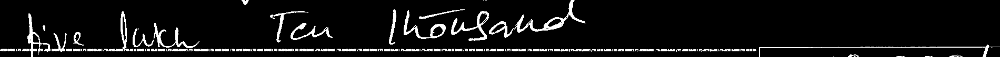

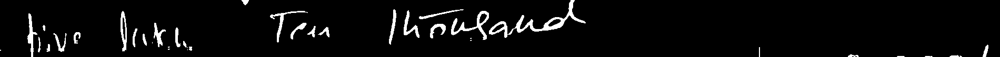

**


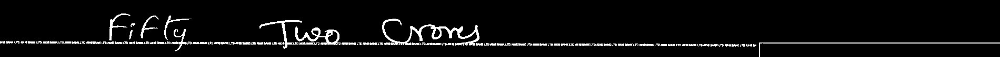

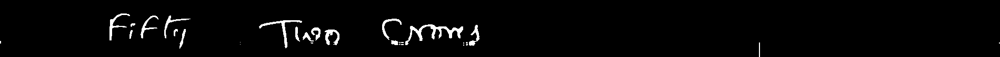

**


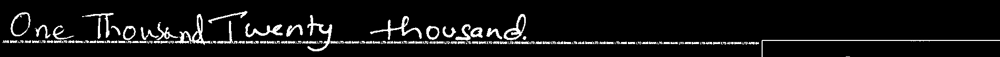

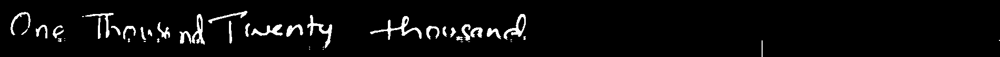

**


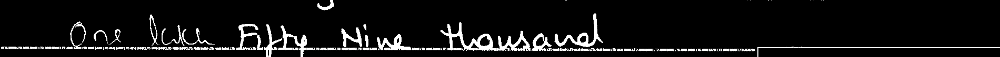

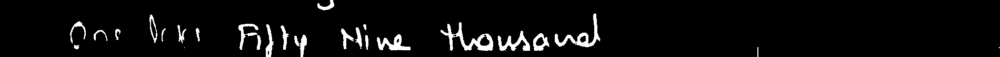

**


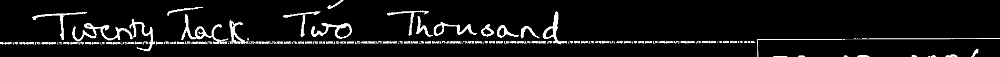

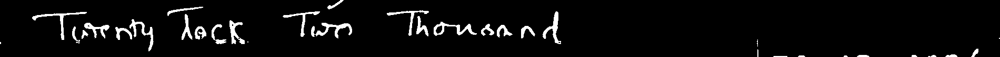

**


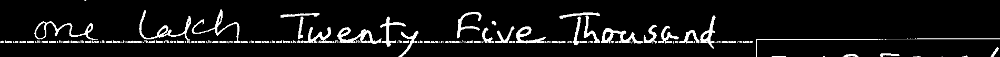

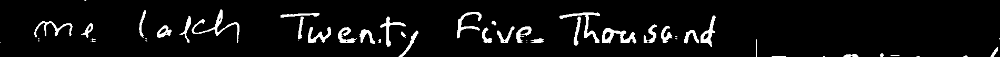

**


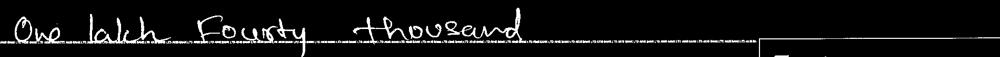

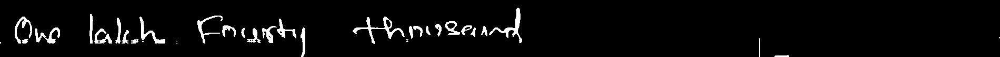

**


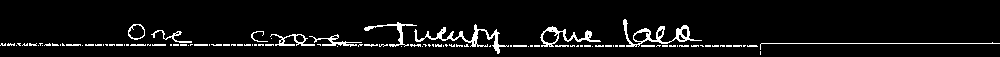

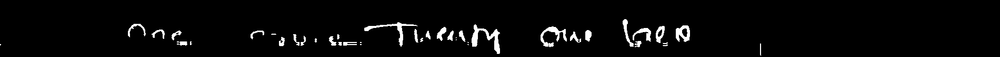

**


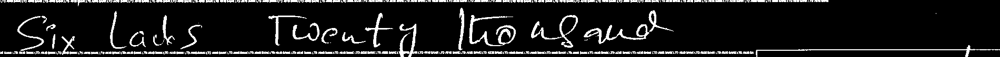

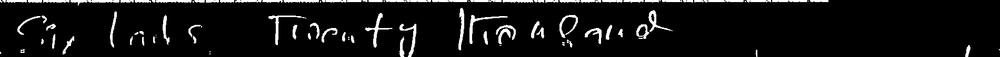

**


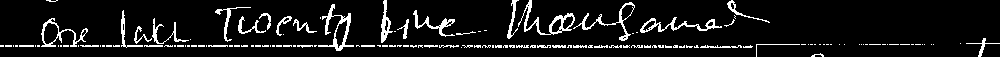

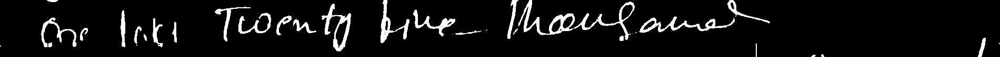

**


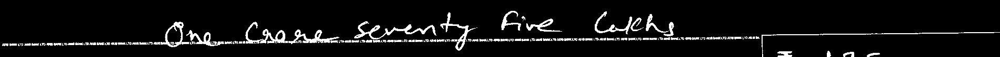

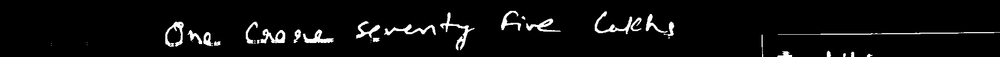

**


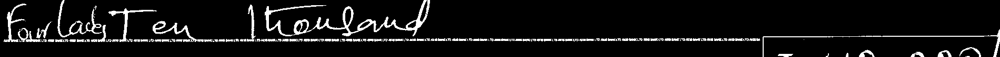

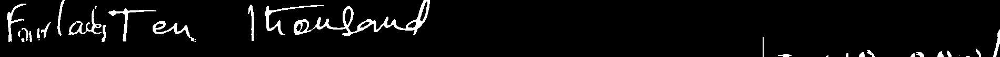

**


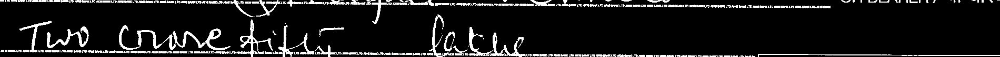

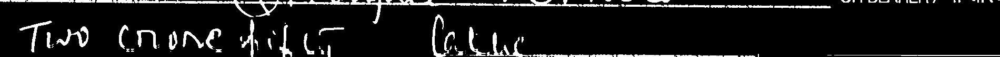

**


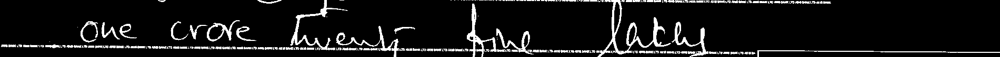

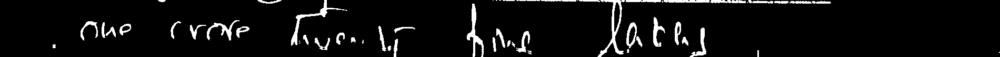

**


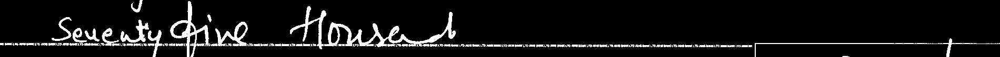

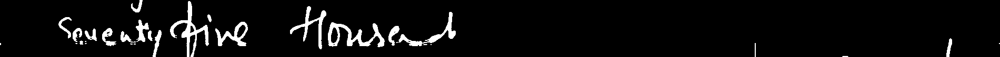

**


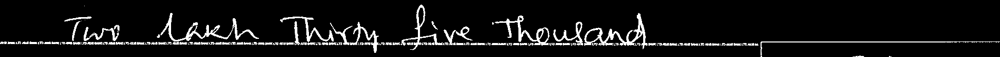

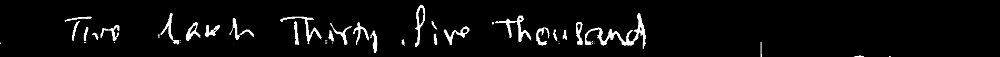

**


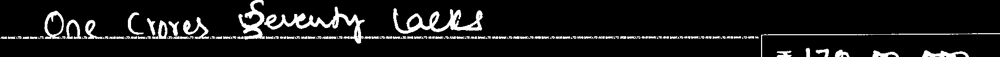

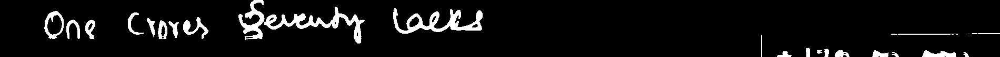

**


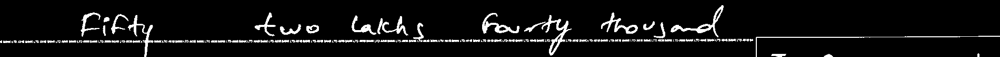

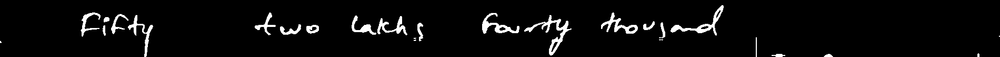

**


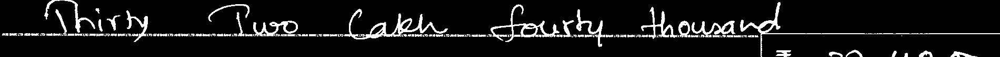

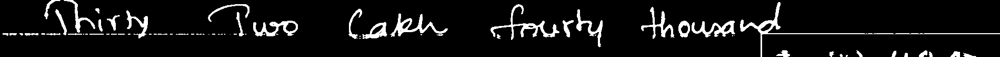

**


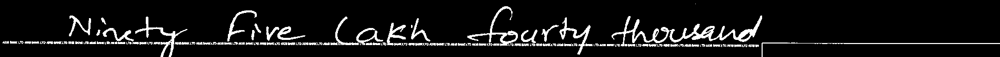

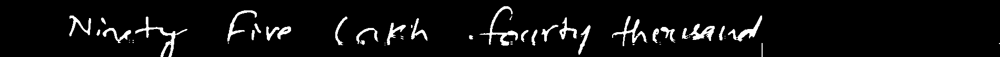

**


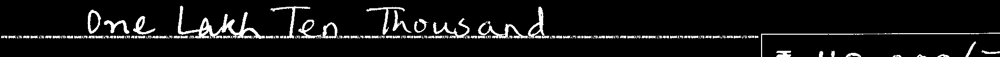

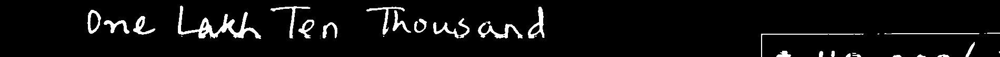

**


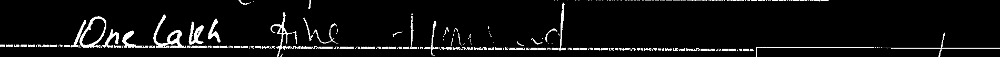

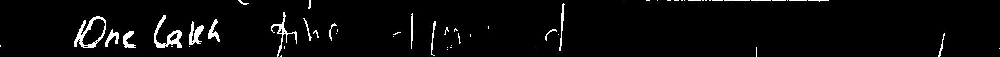

**


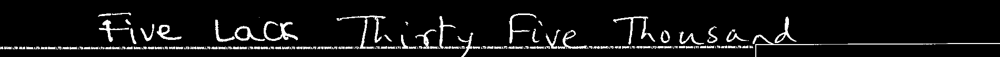

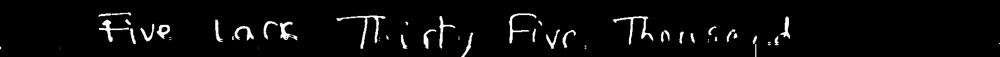

**


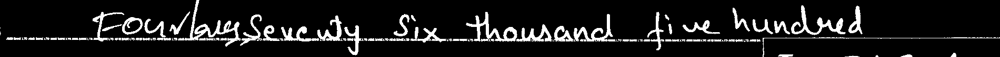

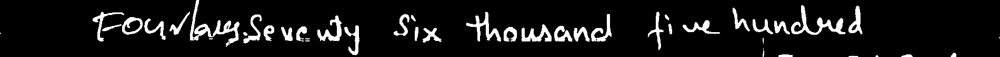

**


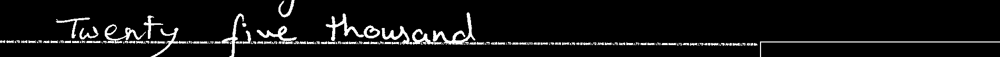

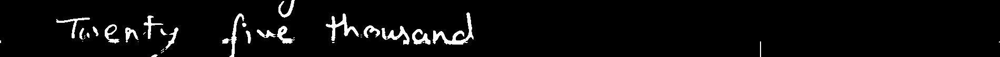

**


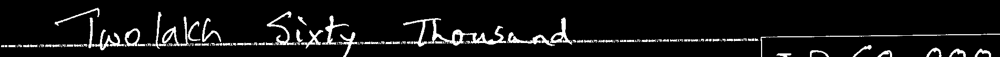

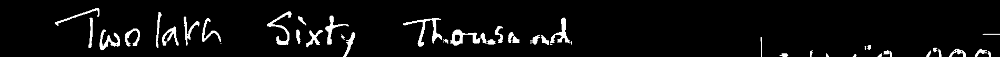

**


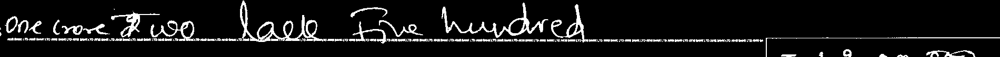

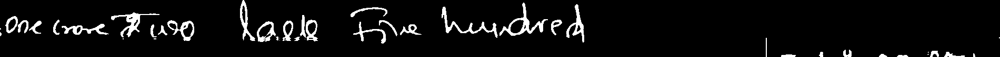

**


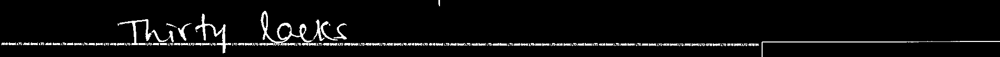

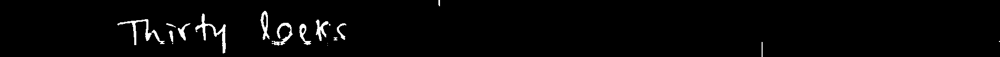

**


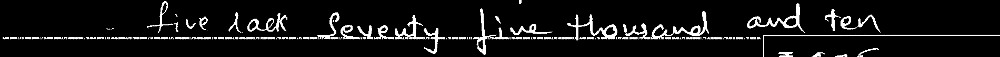

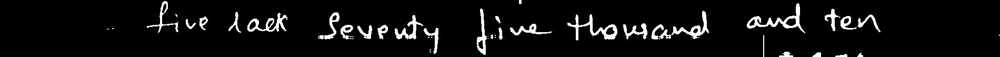

**


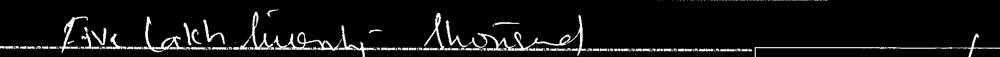

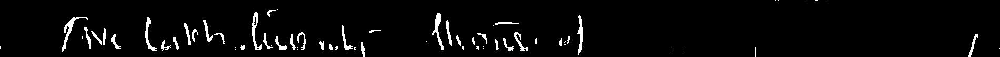

**


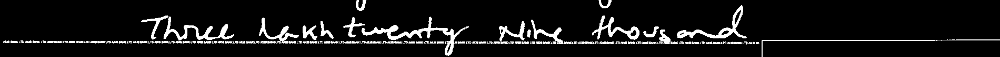

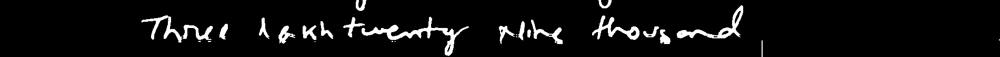

**


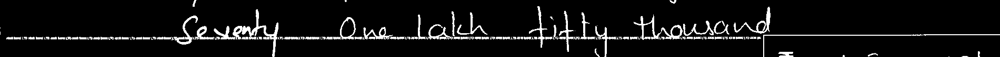

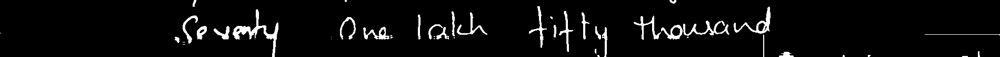

**


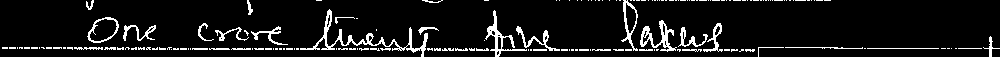

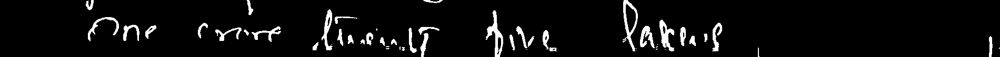

**


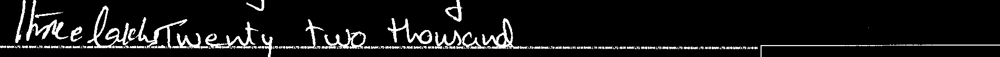

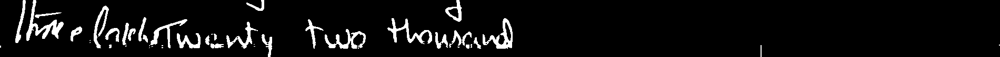

**


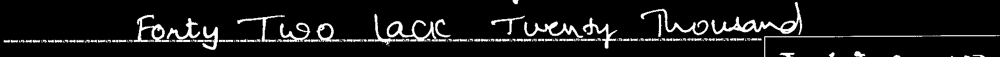

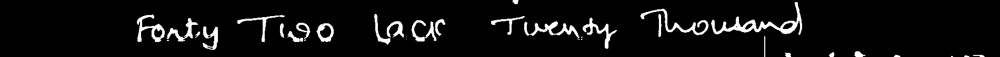

**


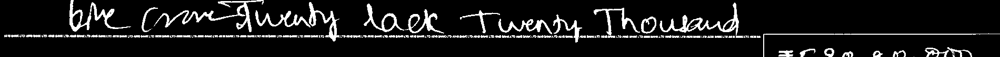

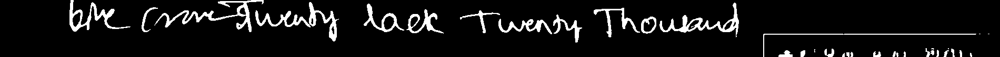

**


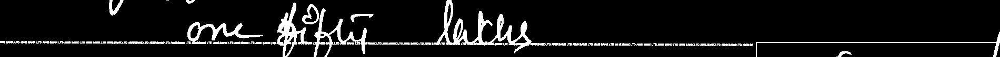

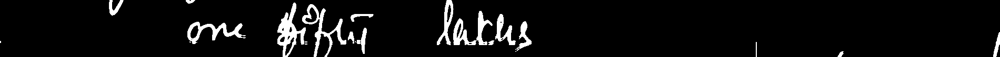

**


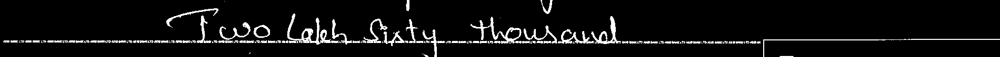

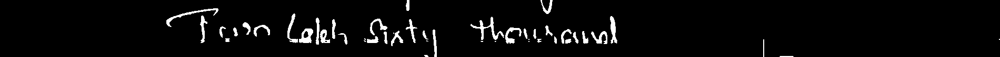

**


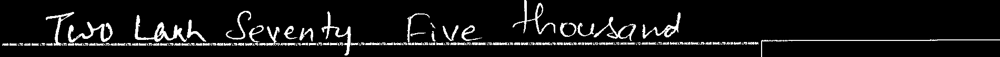

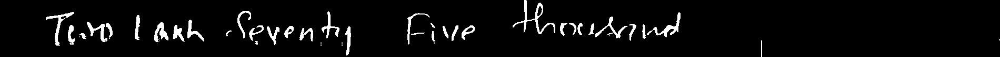

**


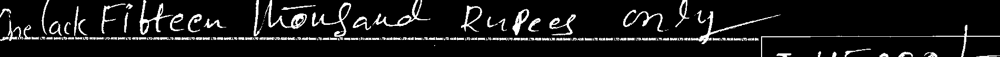

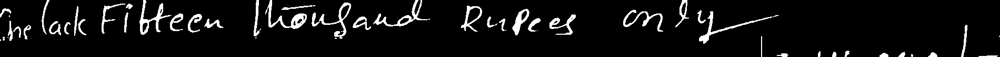

**


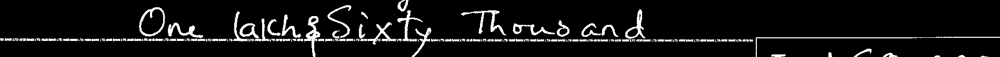

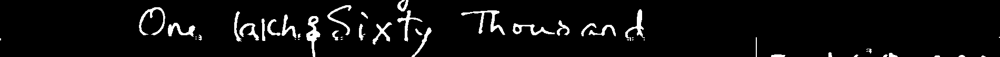

**


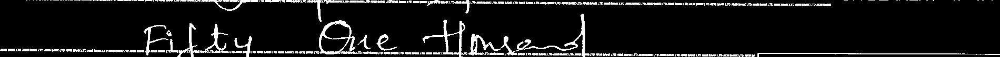

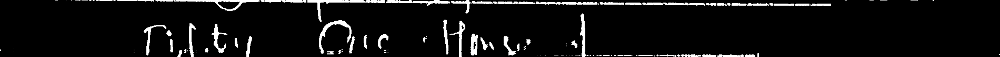

**


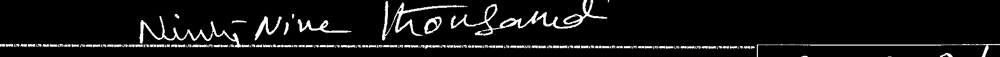

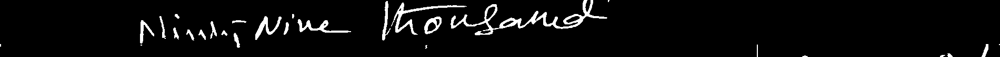

**


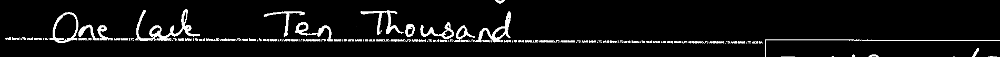

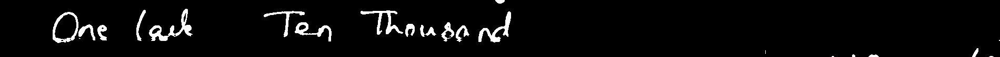

**


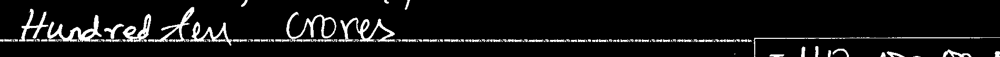

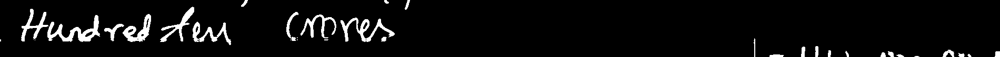

**


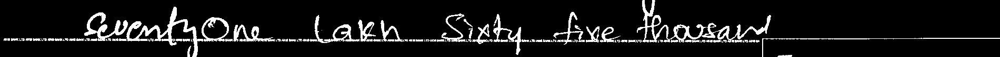

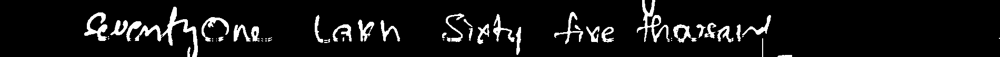

**


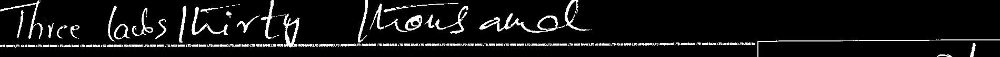

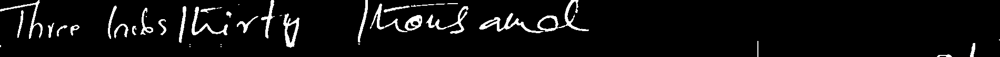

**


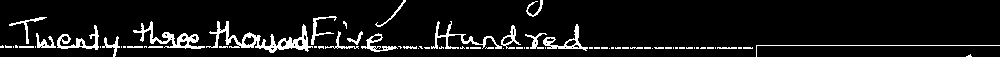

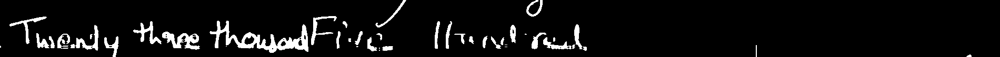

**


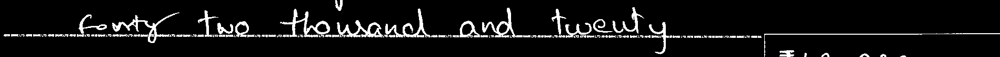

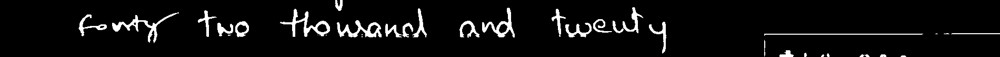

**


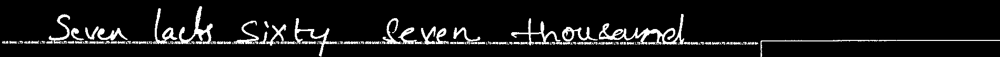

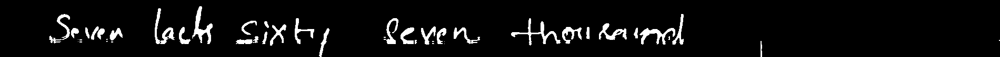

**


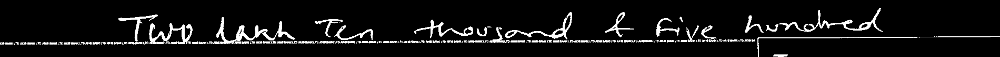

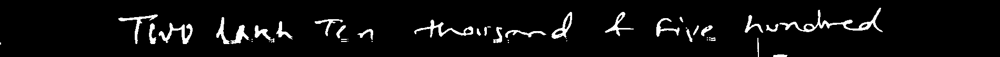

**


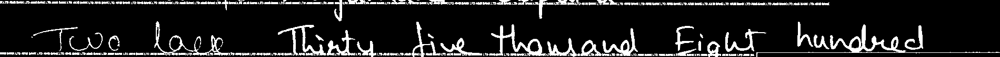

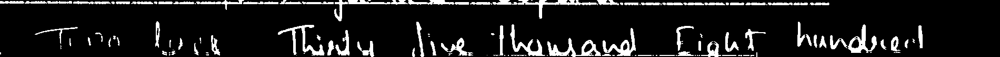

**


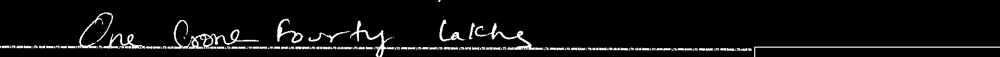

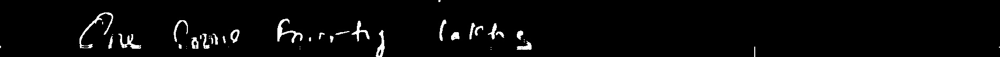

**


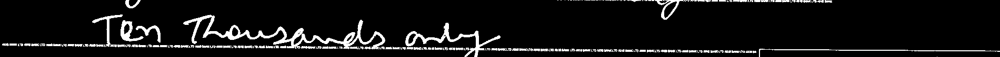

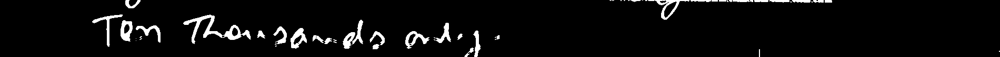

**


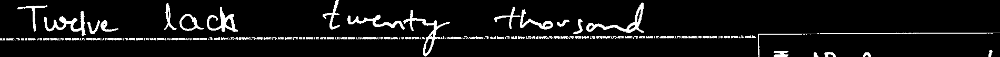

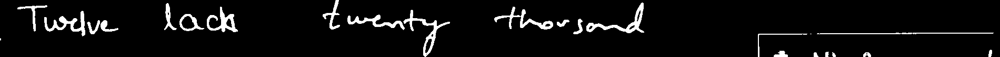

**


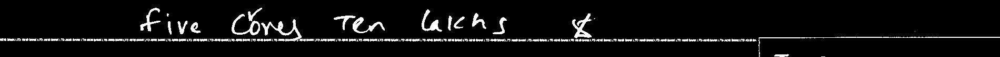

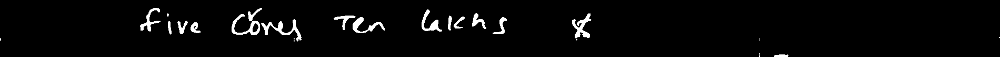

**


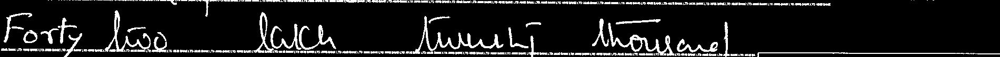

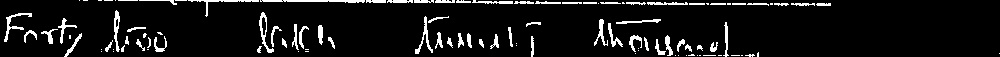

**


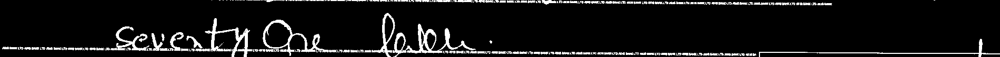

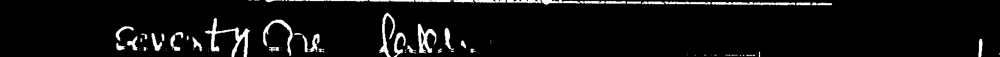

**


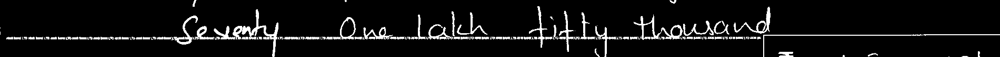

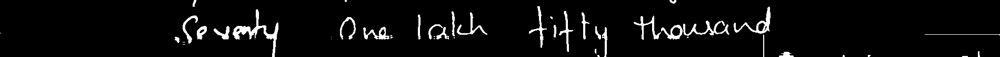

**


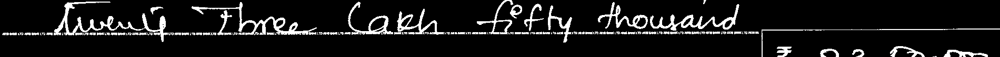

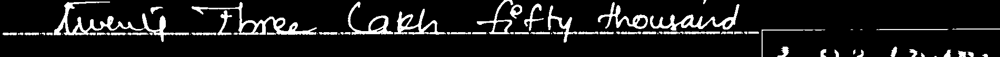

**


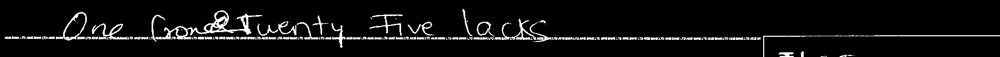

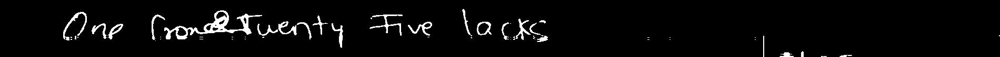

**


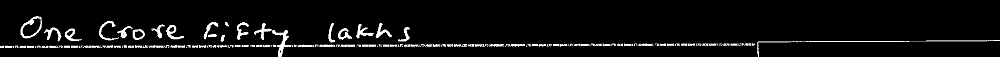

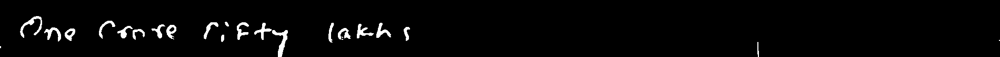

**


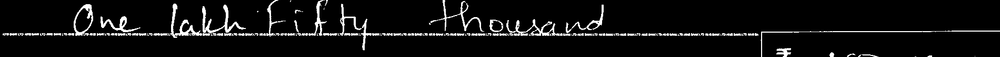

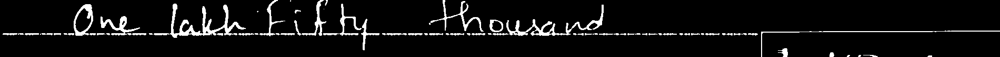

**


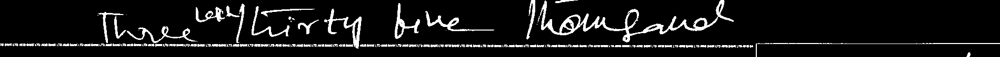

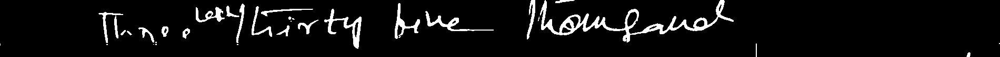

**


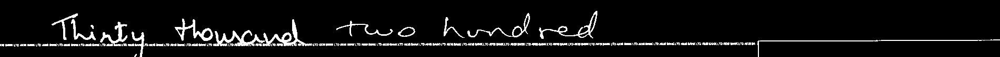

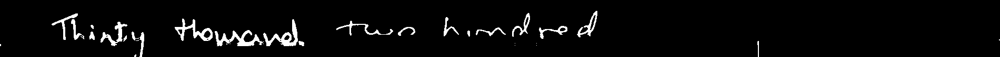

**


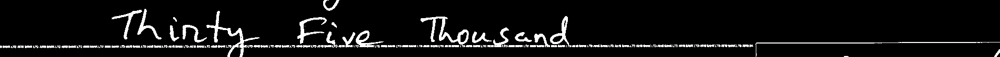

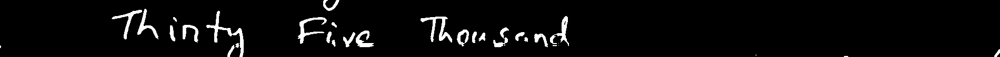

**


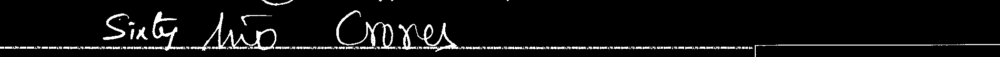

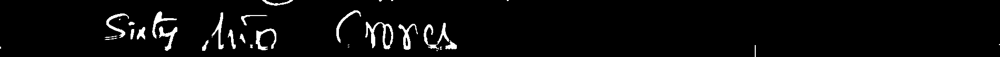

**


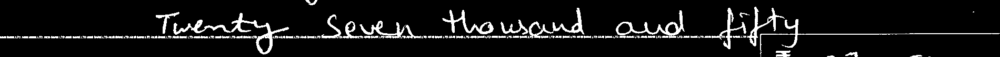

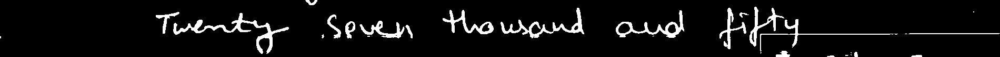

**


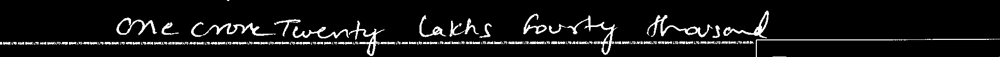

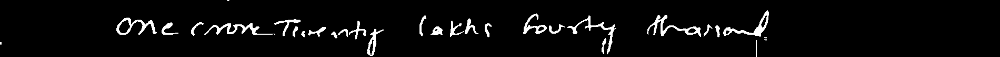

**


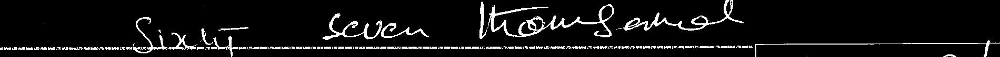

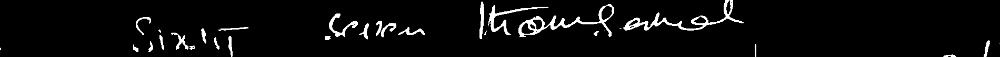

**


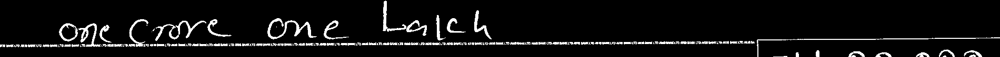

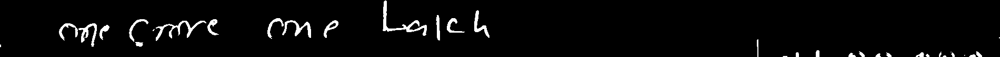

**


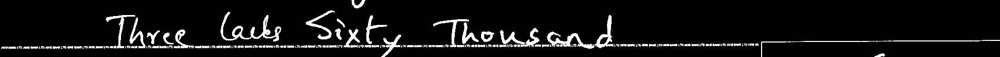

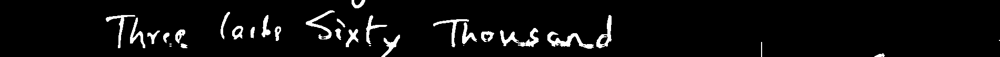

**


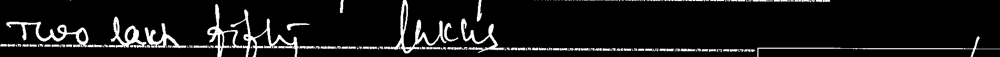

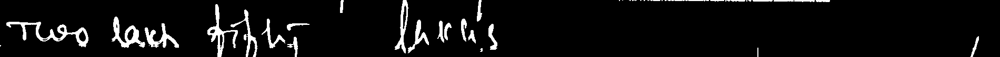

**


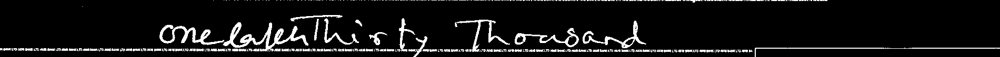

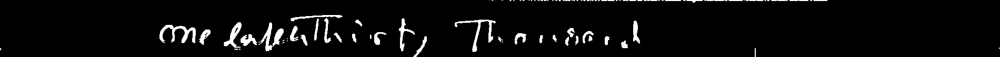

**


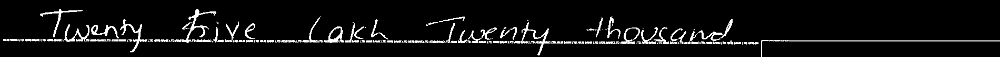

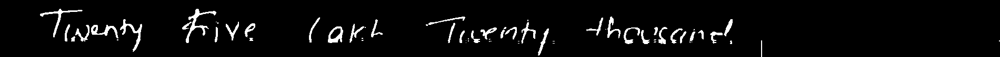

**


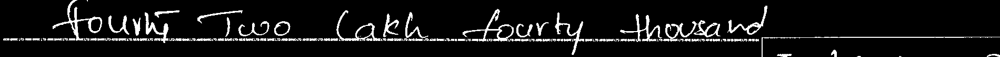

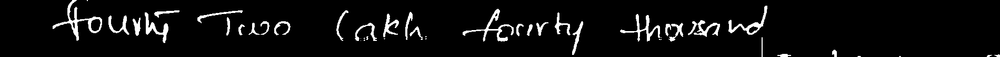

**


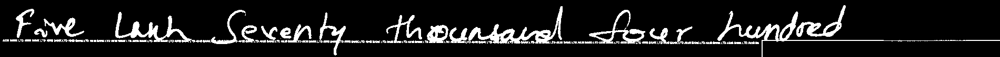

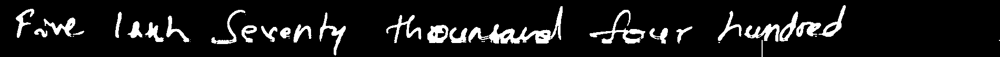

**


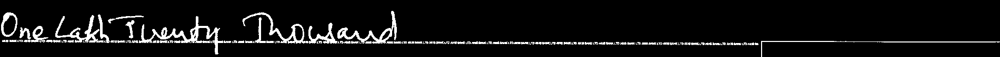

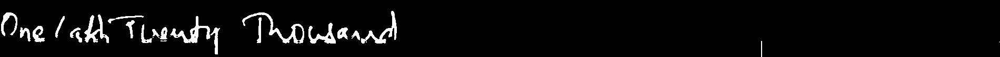

**


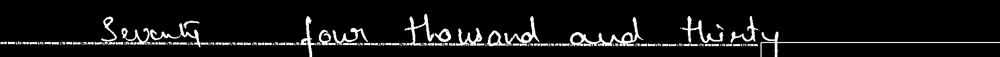

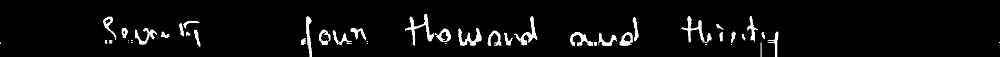

**


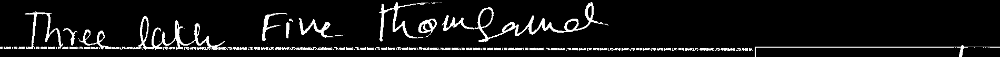

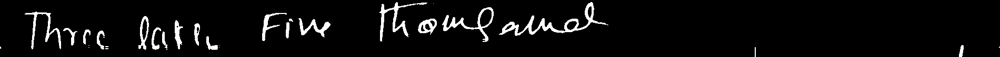

**


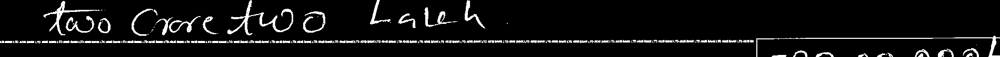

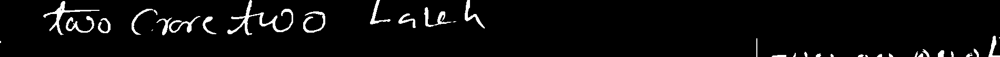

**


In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=250
      x=160
      h=110
      w=1900
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      cv2_imshow(image)
      # image = cv2.dilate(image,kernel,iterations = 1) 
      for i in range(67,image.shape[0]-4):
          for j in range(2,image.shape[1]-2):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
                      
              else:
                    image[i,j]=0
     
    #   for i in range(0,image.shape[0]-10):
    #       for j in range(2,image.shape[1]-2):
    # # for z in range (1,200):
    #           if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
    #                 image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
 
      cv2_imshow(th3)
      print("**")
      cv2.waitKey(0) 

# Chèque catégorie 4

In [ ]:
dirNameDataPNG = 'dataPNG3'
if not os.path.exists(dirNameDataPNG):
  os.mkdir(dirNameDataPNG)
  print("Directory " , dirNameDataPNG ,  " Created ")
else:    
  print("Directory " , dirNameDataPNG ,  " already exists")

Directory  dataPNG3  Created 


In [ ]:
base_path = "/content/gdrive/MyDrive/blue/"
new_path = "/content/dataPNG3/"
for infile in os.listdir(base_path):
  if not "ipynb_checkpoints" in infile:
    print ("file : " + infile)
    read = cv2.imread(base_path + infile)
    outfile = infile.split('.')[0] + '.png'
    cv2.imwrite("/content/"+dirNameDataPNG+"/"+outfile,read,[int(cv2.IMWRITE_JPEG_QUALITY), 200])

file : Cheque 100828.tif
file : Cheque 100829.tif
file : Cheque 100830.tif
file : Cheque 100831.tif
file : Cheque 100832.tif
file : Cheque 100833.tif
file : Cheque 100834.tif
file : Cheque 100835.tif


In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      image = cv2.imread(new_path+infile)
      resized = cv2.resize(image, (2300,1000),)
      cv2.imwrite(new_path+infile,resized)
      print(resized.shape)
      
      print("")

file : Cheque 100835.png
(1000, 2300, 3)

file : Cheque 100828.png
(1000, 2300, 3)

file : Cheque 100829.png
(1000, 2300, 3)

file : Cheque 100830.png
(1000, 2300, 3)

file : Cheque 100831.png
(1000, 2300, 3)

file : Cheque 100833.png
(1000, 2300, 3)

file : Cheque 100834.png
(1000, 2300, 3)

file : Cheque 100832.png
(1000, 2300, 3)



In [ ]:
def center_crop(im, crop_pixels = 45):
    return im[crop_pixels:im.shape[0] - crop_pixels*3, crop_pixels:im.shape[1] - crop_pixels]

In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      print ("file : " + infile)
      im = Image.open(new_path+infile)
      image = cv2.imread(new_path+infile)
      cropped = center_crop(image)
      cv2.imwrite(new_path+infile,cropped)
      print(cropped.shape)
      
      print("")

file : Cheque 100835.png
(820, 2210, 3)

file : Cheque 100828.png
(820, 2210, 3)

file : Cheque 100829.png
(820, 2210, 3)

file : Cheque 100830.png
(820, 2210, 3)

file : Cheque 100831.png
(820, 2210, 3)

file : Cheque 100833.png
(820, 2210, 3)

file : Cheque 100834.png
(820, 2210, 3)

file : Cheque 100832.png
(820, 2210, 3)



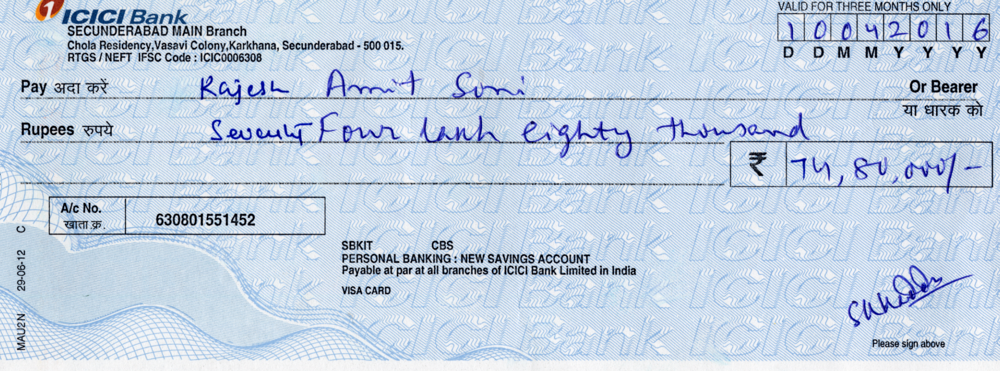

In [ ]:
image1 = cv2.imread("/content/dataPNG3/Cheque 100832.png")
cv2_imshow(image1)

# result

Before


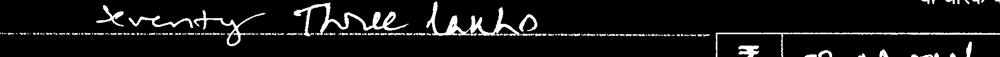

After


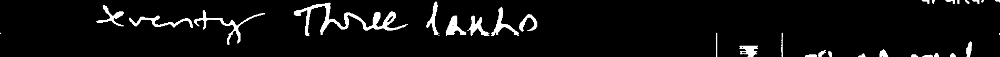

Before


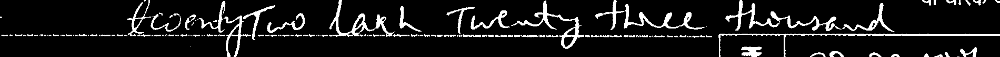

After


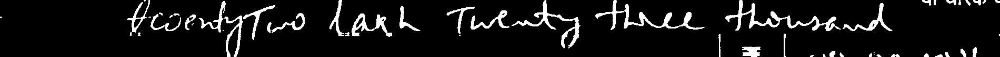

Before


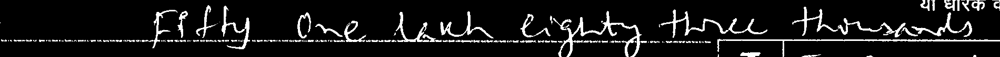

After


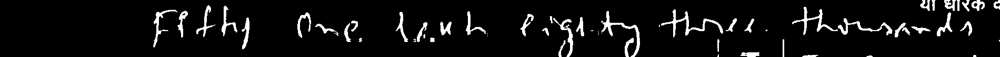

Before


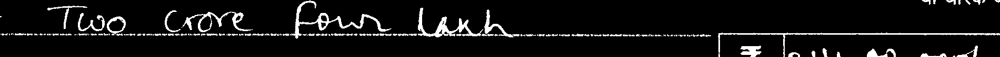

After


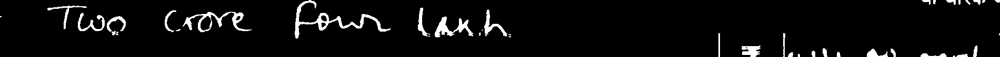

Before


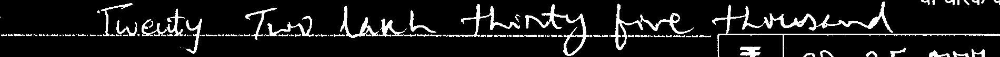

After


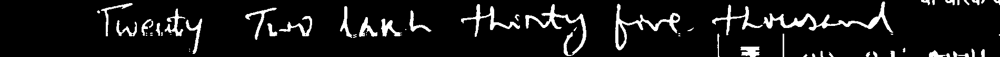

Before


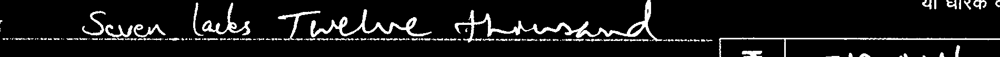

After


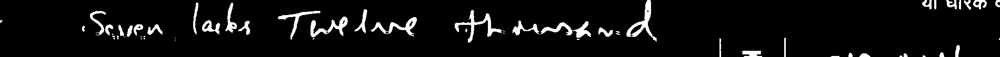

Before


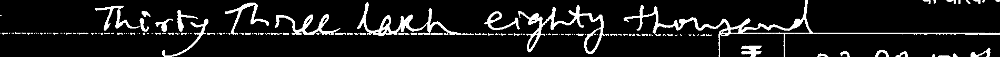

After


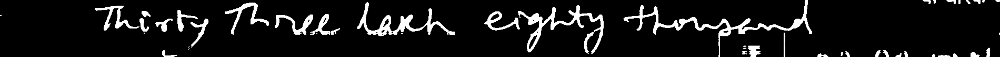

Before


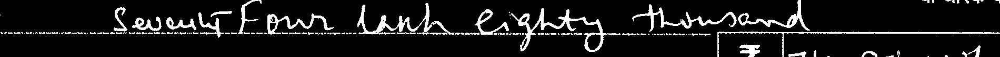

After


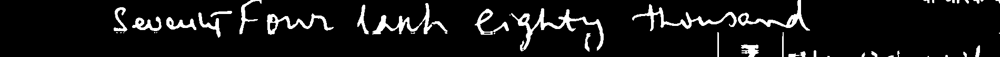

In [ ]:
for infile in os.listdir(new_path):
    if not "ipynb_checkpoints" in infile:
      image = cv2.imread(new_path+infile)
      image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
      thresh = thresholding(image)
      image=deskew(thresh)
      # converting to its binary form
      bw = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
      y=250
      x=250
      h=110
      w=1900
      image = image[y:y+h, x:x+w]
      image = cv2.bitwise_not(image)
      kernel = np.ones((3,3),np.uint8)
      print("Before")
      cv2_imshow(image)
      for i in range(60,image.shape[0]-4):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
          # elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
          #               
              else:
                    image[i,j]=0
     
      for i in range(0,image.shape[0]-25):
          for j in range(2,image.shape[1]-2):
    # for z in range (1,200):
              if image[i,j]==255 and (image[i-4,j]==255 or image[i+4,j]==255):
                    image[i,j]=255
              #elif crop1[i,j]==0 and (crop1[i-3,j]==255 or crop1[i+3,j]==255) and crop1[i,j+z]==0:  
                        
      blur = cv2.GaussianBlur(image,(5,5),0)
      ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
      #th3 = cv2.dilate(th3,kernel,iterations = 1) 
      print("After")
      cv2_imshow(th3)
      cv2.waitKey(0) 

# **Transfert learning EMNIST**

In [ ]:
import keras
from keras.datasets import mnist
from keras.models import Sequential
from keras.layers import Dense,Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
import pandas as pd
import numpy as np
from keras.models import load_model
import matplotlib.pyplot as plt
from scipy.ndimage import rotate
import imageio
import PIL
from PIL import Image
from skimage import transform,io
import scipy.io as sio
import scipy.misc
from skimage.transform import rescale, resize as rs, downscale_local_mean

In [ ]:
model=load_model('model.h5')


OSError: ignored